Inspired by this notebook https://colab.research.google.com/github/roboflow-ai/notebooks/blob/main/notebooks/how-to-segment-anything-with-sam.ipynb#scrollTo=Aszw1OxBwowI

In [2]:
!ls ~/data/extra_models_weights

sam_vit_h_4b8939.pth


In [1]:
import os

CHECKPOINT_PATH = os.path.join("/home/dimakot55/data/extra_models_weights/sam_vit_h_4b8939.pth")
print(CHECKPOINT_PATH, "; exist:", os.path.isfile(CHECKPOINT_PATH))

/home/dimakot55/data/extra_models_weights/sam_vit_h_4b8939.pth ; exist: True


In [2]:
import torch

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"

In [3]:
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor
from PIL import Image
import supervision as sv
import numpy as np
mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)
sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)

In [4]:
mask_generator = SamAutomaticMaskGenerator(sam)

In [5]:


image_rgb = np.array(Image.open("/home/dimakot55/data/nerf_synthetic/hotdog/train/r_40.png").convert('RGB'))
image_bgr = np.array(image_rgb[...,[2,1,0]])
sam_result = mask_generator.generate(image_rgb)

In [6]:
image_rgb

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)

In [7]:
sam_result

[{'segmentation': array([[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]),
  'area': 101108,
  'bbox': [64, 280, 663, 338],
  'predicted_iou': 1.0228123664855957,
  'point_coords': [[187.5, 337.5]],
  'stability_score': 0.9782676696777344,
  'crop_box': [0, 0, 800, 800]},
 {'segmentation': array([[False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         ...,
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False],
         [False, False, False, ..., False, False, False]]),
  'area': 6438,
  'bbox': [522, 413, 123, 

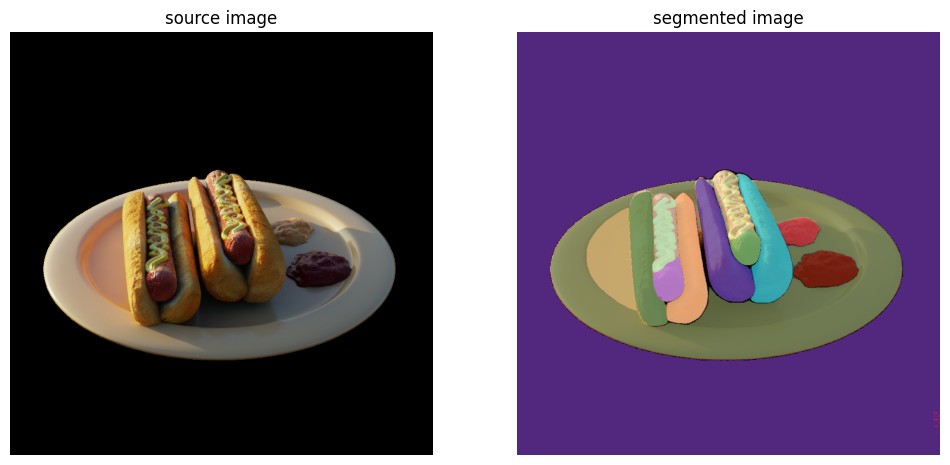

In [8]:
mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)

detections = sv.Detections.from_sam(sam_result=sam_result)

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[image_bgr, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

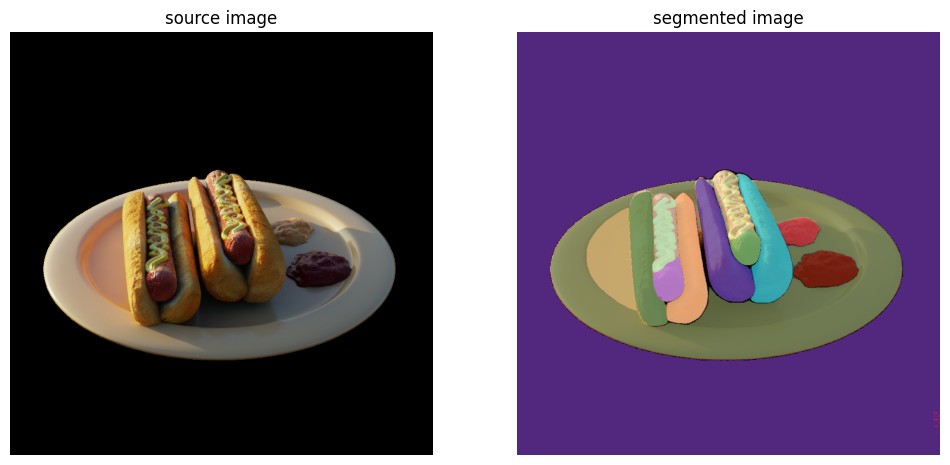

In [9]:

detections = sv.Detections.from_sam(sam_result=sam_result)

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[image_bgr, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

In [19]:
len(masks)

19

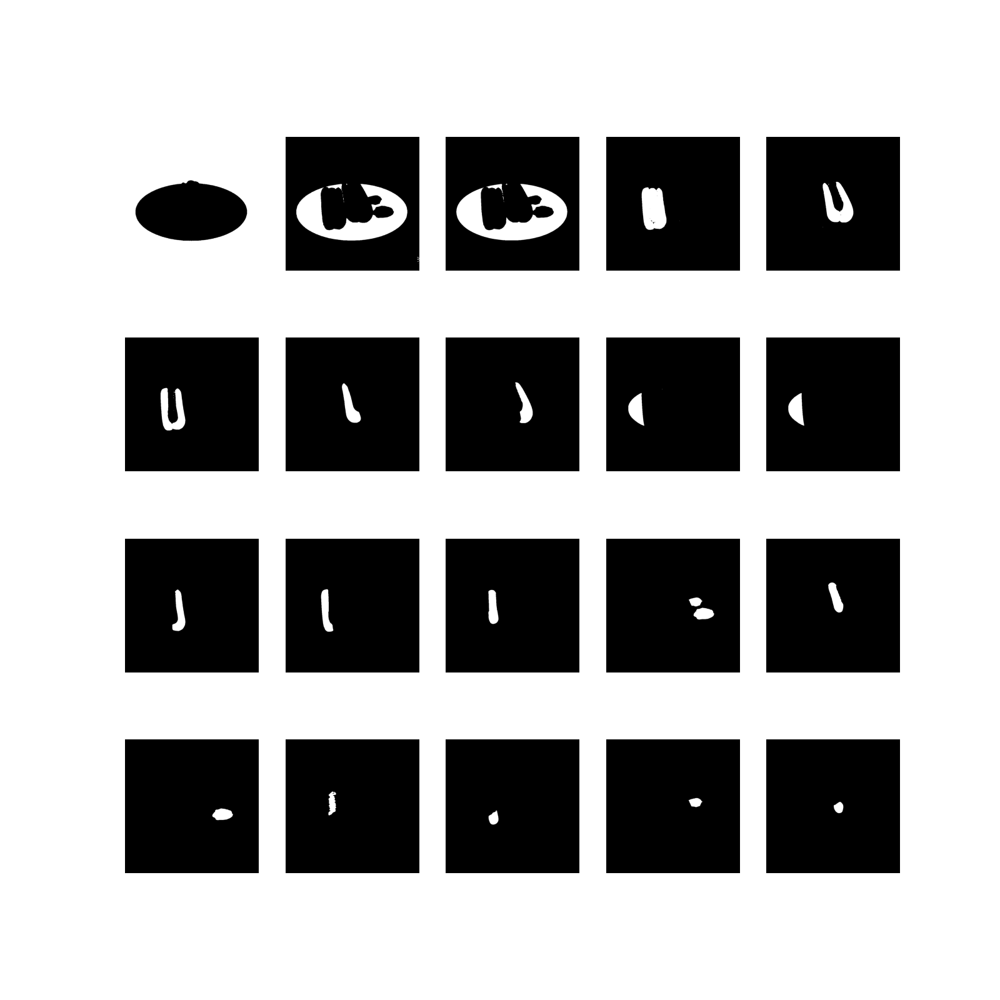

In [117]:
masks = [
    mask['segmentation']
    for mask
    in sorted(sam_result, key=lambda x: x['area'], reverse=True)
]

sv.plot_images_grid(
    images=masks,
    grid_size=(4, 5),
    size=(16, 16)
)

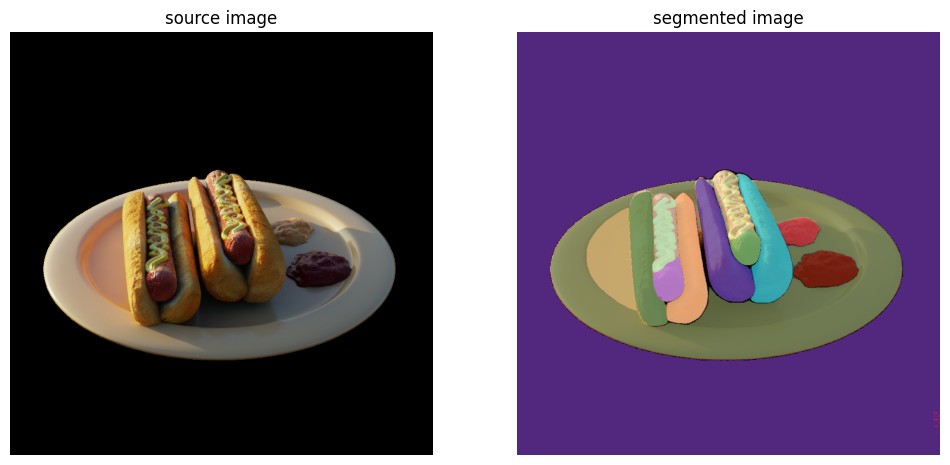

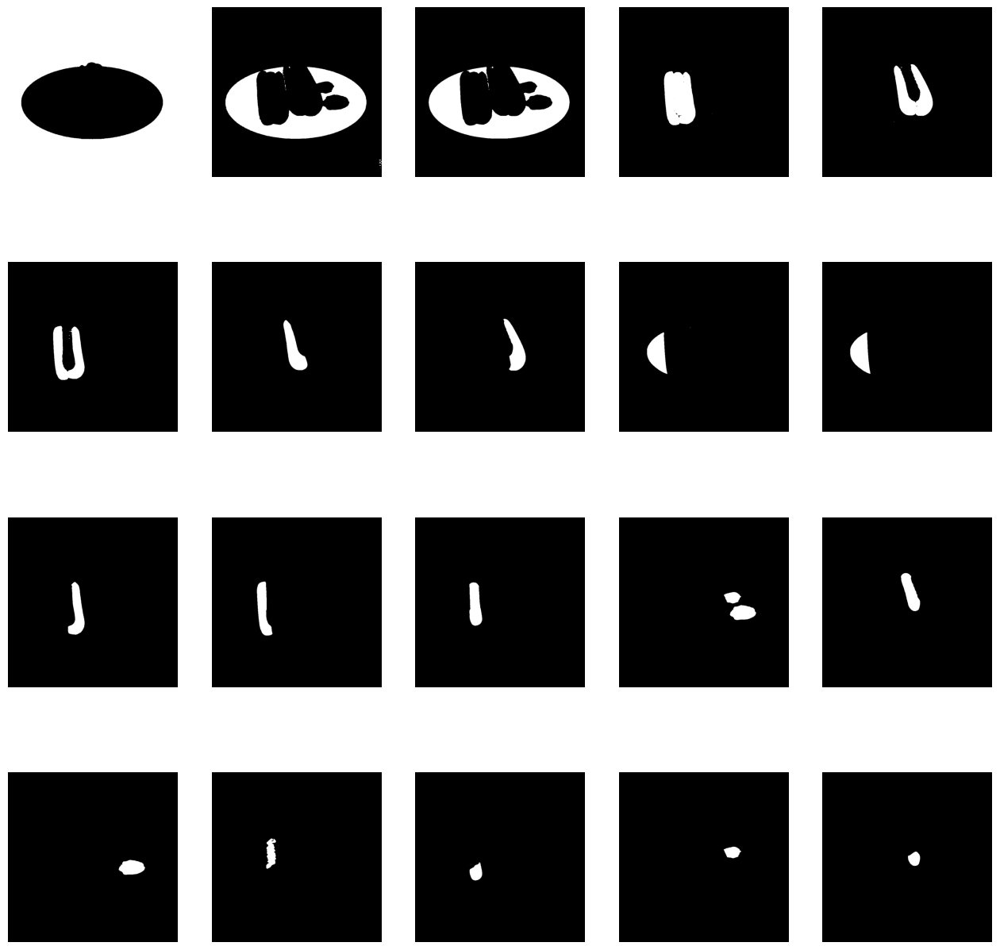

In [25]:

detections = sv.Detections.from_sam(sam_result=sam_result)

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[image_bgr, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

masks = [
    mask['segmentation']
    for mask
    in sorted(sam_result, key=lambda x: x['area'], reverse=True)
]

sv.plot_images_grid(
    images=masks,
    grid_size=(4, 5),
    size=(16, 16)
)

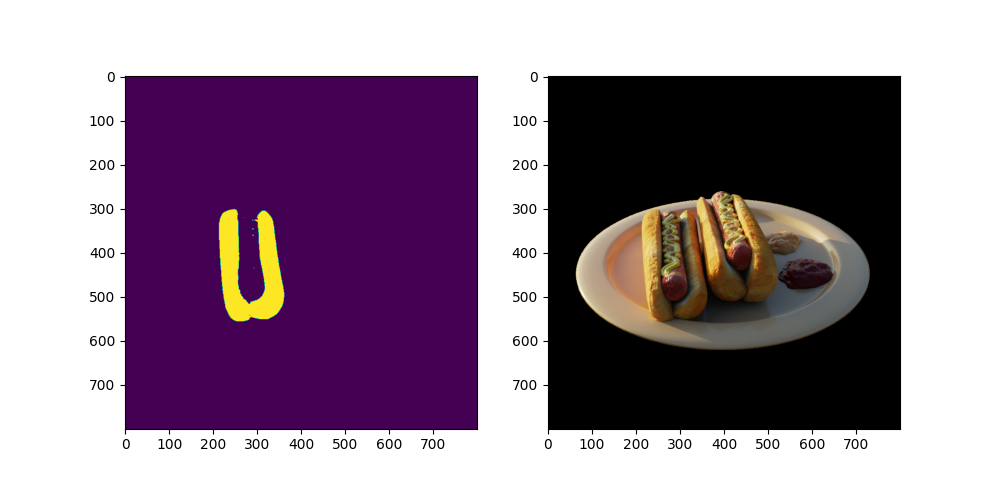

In [118]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))

ax[0].imshow(masks[5])
ax[1].imshow(image_rgb)
plt.show()



In [125]:
np.where(np.max(image_rgb * np.expand_dims(masks[5], axis=-1), axis=-1))

(array([301, 302, 302, ..., 555, 555, 555]),
 array([247, 241, 242, ..., 267, 268, 269]))

In [126]:
np.where(masks[5])

(array([301, 302, 302, ..., 555, 555, 555]),
 array([247, 241, 242, ..., 267, 268, 269]))

In [129]:
image_rgb[np.where(masks[5])].shape

(21453, 3)

# Incorporate into real gaussians

In [10]:
from PIL import Image
import numpy as np 
import os 


import numpy as np
import matplotlib.pyplot as pl
import torch
import ot
import ot.plot

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Enable interactive mode
%matplotlib ipympl
os.environ["CUDA_VISIBLE_DEVICES"] = "1" # has not effect

import sys
sys.path.append("../")
device="cuda"
from tqdm import tqdm_notebook as tqdm

from gaussian_renderer import render, network_gui
from arguments import ModelParams, PipelineParams, OptimizationParams
import argparse
from scene import Scene, GaussianModel
from random import randint
from argparse import ArgumentParser, Namespace

saving_steps = [1, 100, 300, 1_000, 3_000, 7_000, 10_000, 15_000, 20_000, 30_000]
parser = ArgumentParser(description="Training script parameters")
lp = ModelParams(parser)
op = OptimizationParams(parser)
pp = PipelineParams(parser)
parser.add_argument('--ip', type=str, default="127.0.0.1")
parser.add_argument('--port', type=int, default=6009)
parser.add_argument('--debug_from', type=int, default=-1)
parser.add_argument('--detect_anomaly', action='store_true', default=False)
parser.add_argument("--test_iterations", nargs="+", type=int, default=saving_steps)
parser.add_argument("--save_iterations", nargs="+", type=int, default=saving_steps)
parser.add_argument("--quiet", action="store_true")
parser.add_argument("--checkpoint_iterations", nargs="+", type=int, default=saving_steps)# default=[])
parser.add_argument("--start_checkpoint", type=str, default = None)
args = parser.parse_args(("-s /home/dimakot55/data/nerf_synthetic/hotdog/ "+\
                         "--model_path /home/dimakot55/workspace/gaussian-splatting/notebooks/GT_lego_cluster2_test_notebook14/").split())#sys.argv[1:])
#args.save_iterations.append(args.iterations)
dataset=lp.extract(args)
pipe=pp.extract(args)
opt=op.extract(args)
os.makedirs(args.model_path, exist_ok=True)

In [11]:

# Functions from @Mateen Ulhaq and @karlo for visualizing 3d points with equal scaling of axes
def set_axes_equal(ax: plt.Axes):
    """Set 3D plot axes to equal scale.

    Make axes of 3D plot have equal scale so that spheres appear as
    spheres and cubes as cubes.  Required since `ax.axis('equal')`
    and `ax.set_aspect('equal')` don't work on 3D.
    """
    limits = np.array([
        ax.get_xlim3d(),
        ax.get_ylim3d(),
        ax.get_zlim3d(),
    ])
    origin = np.mean(limits, axis=1)
    radius = 0.5 * np.max(np.abs(limits[:, 1] - limits[:, 0]))
    _set_axes_radius(ax, origin, radius)

def _set_axes_radius(ax, origin, radius):
    x, y, z = origin
    ax.set_xlim3d([x - radius, x + radius])
    ax.set_ylim3d([y - radius, y + radius])
    ax.set_zlim3d([z - radius, z + radius])



In [12]:
os.makedirs(args.model_path, exist_ok=True)
content_gaussians = GaussianModel(3)
content_scene = Scene(dataset, content_gaussians, shuffle=True)
content_gaussians.training_setup(opt)

Found transforms_train.json file, assuming Blender data set!
Reading Training Transforms
Reading Test Transforms
Loading Training Cameras
Loading Test Cameras
Number of points at initialisation :  100000


In [13]:
content_gaussians._xyz.shape

torch.Size([100000, 3])

In [131]:
content_gaussians.restore(torch.load("/home/dimakot55/output_data/gs/GT_hotdog/chkpnt30000.pth")[0], opt)

In [15]:
# Turn color into coordinates. We will need that to optimize 
# Remove view dependent effects and make all the gaussians opaque. 
# That helps with getting a better mesh
content_gaussians._opacity.data +=  1e6
content_gaussians_features_ds_original = content_gaussians._features_dc.detach().clone()
content_gaussians._features_dc.data = content_gaussians._xyz.data.clone().detach().unsqueeze(1)
content_gaussians._features_rest.data = content_gaussians._features_rest.data * 0.
content_gaussians._scaling.data *=  .98


In [16]:

bg_color = [1, 1, 1] if dataset.white_background else [0, 0, 0]
background = torch.tensor(bg_color, dtype=torch.float32, device=device)
viewpoint_stack = content_scene.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


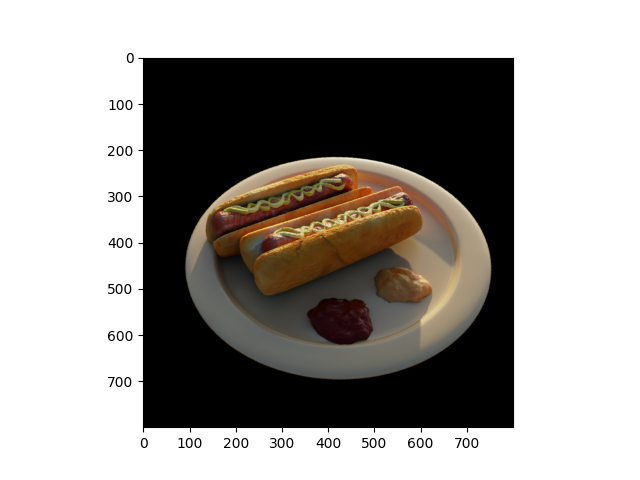

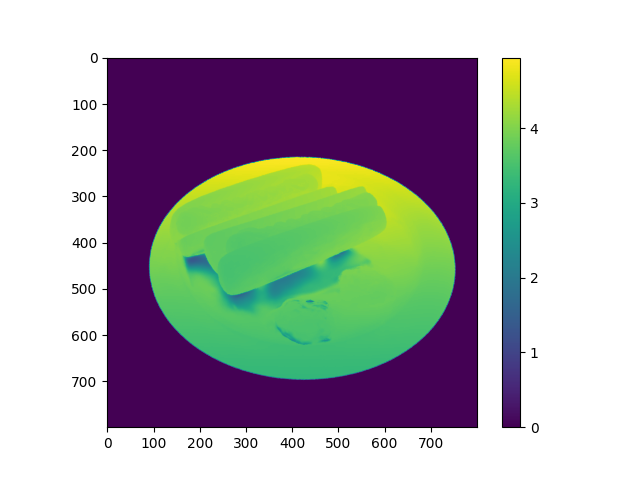

In [30]:

render_pkg = render(viewpoint_cam, content_gaussians, pipe, background)
image, depth, viewspace_point_tensor, visibility_filter, radii = render_pkg["render"], render_pkg["depth"], \
    render_pkg["viewspace_points"], render_pkg["visibility_filter"], render_pkg["radii"]

image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()


depth_np = depth.detach().cpu().numpy()

plt.figure()
plt.imshow(depth_np)
plt.colorbar()
plt.show()


In [18]:
# Init surface and find better initialization points.

In [26]:

def obtain_surface_pc(viewpoint_stack, gaussians, pipe, background, num_viewpoints=40, pc_size=10000):
    import numpy as np
    import skimage.measure, skimage.morphology
    import scipy

    # 1. Render from different viewpoints and extract points
    all_points = []
    for iter in range(min(num_viewpoints, len(viewpoint_stack))):
        viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
        render_pkg_cont = render(viewpoint_cam, gaussians, pipe, background)
        image = render_pkg_cont["render"]
        image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
        image_maxpool = skimage.measure.block_reduce(image_rgb, (3,3,1), np.max)
        mask = scipy.ndimage.binary_erosion(np.max(image_maxpool, axis=-1) > 0.1, structure=None, iterations=5)
        image_clean = image_maxpool * np.expand_dims(mask, axis=-1)
        all_points += list(image_clean[np.min(image_clean, axis=-1)>0.1])
    
    
    # 2. Subsample the points 
    all_points = np.array(all_points)
    all_points_idcs = np.random.choice(range(len(all_points)), size=pc_size, replace=False) 
    all_points = all_points[all_points_idcs]

    # 3. Remove poitns that are too far away from all other points.
    # Compute all pairwise distances between points
    from scipy.spatial import distance
    k=10
    pairwise_distances = distance.cdist(all_points, all_points, 'euclidean')
    # Use np.partition to find the k-th smallest distances for each row
    kth_nearest_indices = np.argpartition(pairwise_distances, k, axis=1)[:, :k]
    kth_nearest_distances = np.take_along_axis(pairwise_distances, kth_nearest_indices, axis=1)
    q_outliers = np.quantile(np.max(kth_nearest_distances, axis=-1), 0.99)
    idcs = np.where(np.max(kth_nearest_distances, axis=-1) < q_outliers)[0]
    all_points = all_points[idcs]

    return all_points
        

In [24]:

content_surface_pc = obtain_surface_pc(viewpoint_stack=viewpoint_stack, 
                               gaussians=content_gaussians, 
                               pipe=pipe, 
                               background=background,
                               num_viewpoints=40)
# Rescale back. This can be a very wrong way to do that. Check better the rasterization code for 
# content_surface_pc_orig = np.array(content_surface_pc)
# coords = content_gaussians._xyz.data.detach().cpu().numpy()
# content_surface_pc = (content_surface_pc - np.min(content_surface_pc)) / (np.max(content_surface_pc)  - np.min(content_surface_pc))
# content_surface_pc = content_surface_pc * (np.max(coords)  - np.min(coords)) + np.min(coords)

In [27]:
content_surface_pc.shape

(9900, 3)

In [22]:
# all_points = content_gaussians._xyz.data.detach().cpu().numpy()
# all_points = content_surface_pc

# all_points = np.array(all_points)
# all_points_idcs = np.random.choice(range(len(all_points)), size=min(10000, len(all_points)) , replace=False) 
# content_surface_pc = all_points[all_points_idcs]

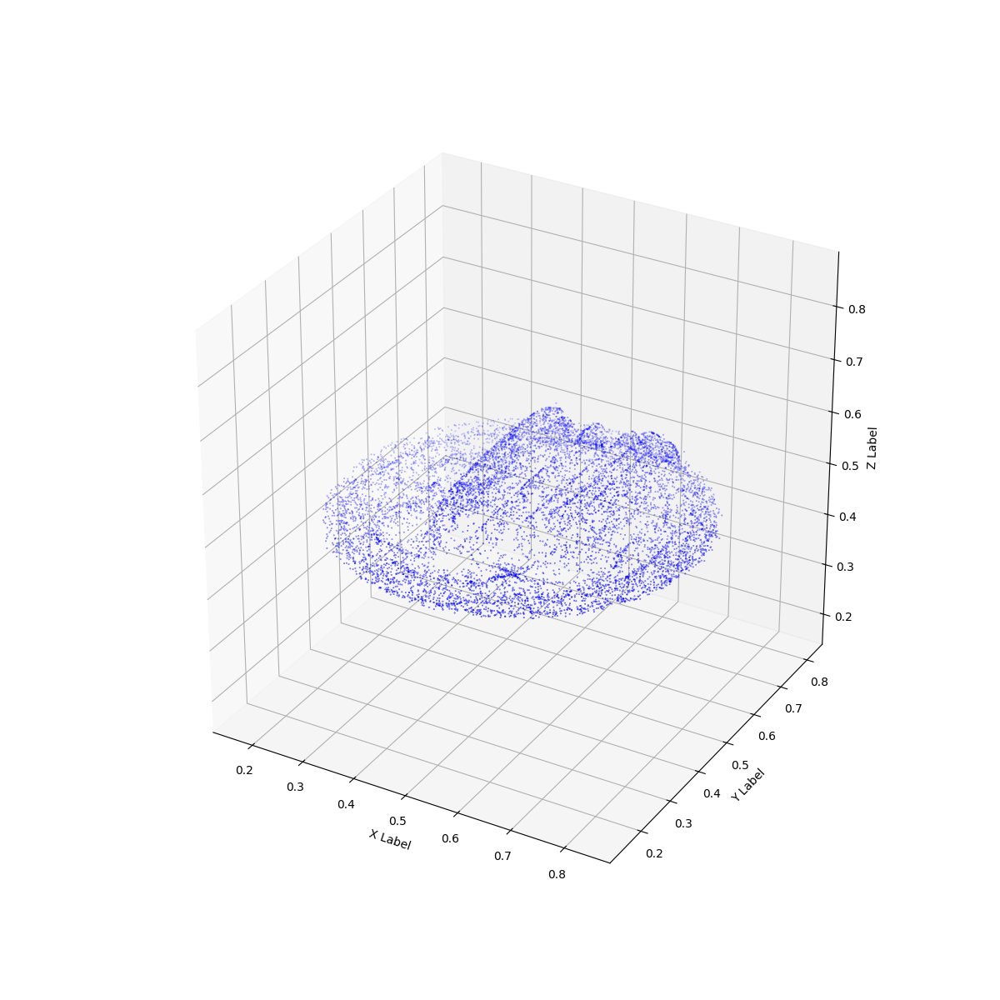

In [28]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc[::kth,0], 
               content_surface_pc[::kth,1], 
               content_surface_pc[::kth,2], c='b', marker='o',s=0.1)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

In [162]:
content_surface_pc

array([[-0.02375438, -0.39164916,  0.24487215],
       [ 0.75285965,  0.81221175, -0.09004548],
       [ 0.12259599, -0.17526385,  0.22127265],
       ...,
       [ 0.2303942 ,  0.8577373 , -0.06296022],
       [ 0.27797094, -0.31228375,  0.15060623],
       [-0.24766223, -0.43131858,  0.2433842 ]], dtype=float32)

In [98]:
content_surface_pc.shape

(50000, 3)

In [99]:
! date
from sklearn.neighbors import KernelDensity
kde = KernelDensity(bandwidth=.02, kernel='gaussian')
kde.fit(content_surface_pc[:50000])
#logprob = kde.score_samples(content_surface_pc[:10000])
! date

Tue Dec  5 12:51:47 PST 2023
Tue Dec  5 12:51:47 PST 2023


In [100]:
! date
logprob = kde.score_samples(content_surface_pc[:50000])
! date

Tue Dec  5 12:51:48 PST 2023
Tue Dec  5 12:53:13 PST 2023


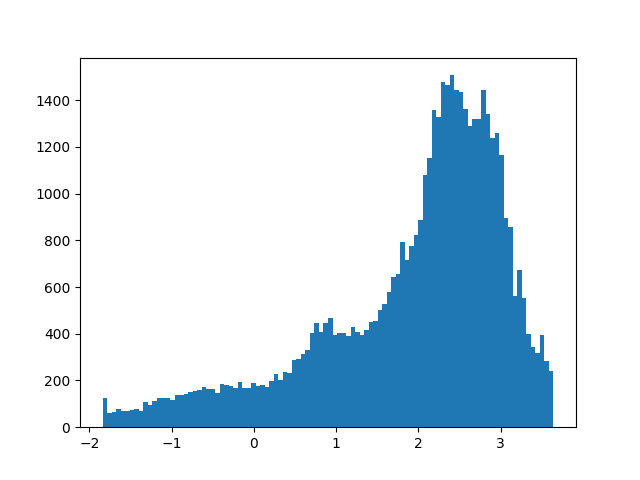

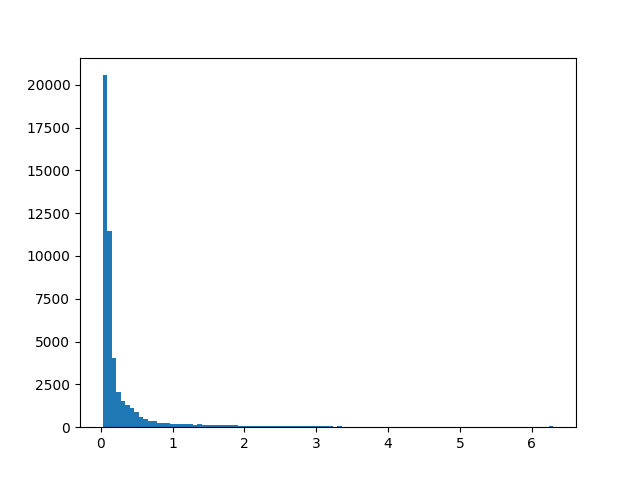

In [101]:
plt.figure()
plt.hist(logprob, bins=100)
plt.show()

plt.figure()
plt.hist(np.exp(-logprob), bins=100)
plt.show()



In [102]:
EPS=1e-6
p=(EPS + np.exp(-logprob))
p = p / np.sum(p)
all_points_idcs2 = np.random.choice(range(len(content_surface_pc)), size=10000, replace=False, p=p )
content_surface_pc2 = content_surface_pc[all_points_idcs2]

NameError: name 'content_surface_pc2' is not defined

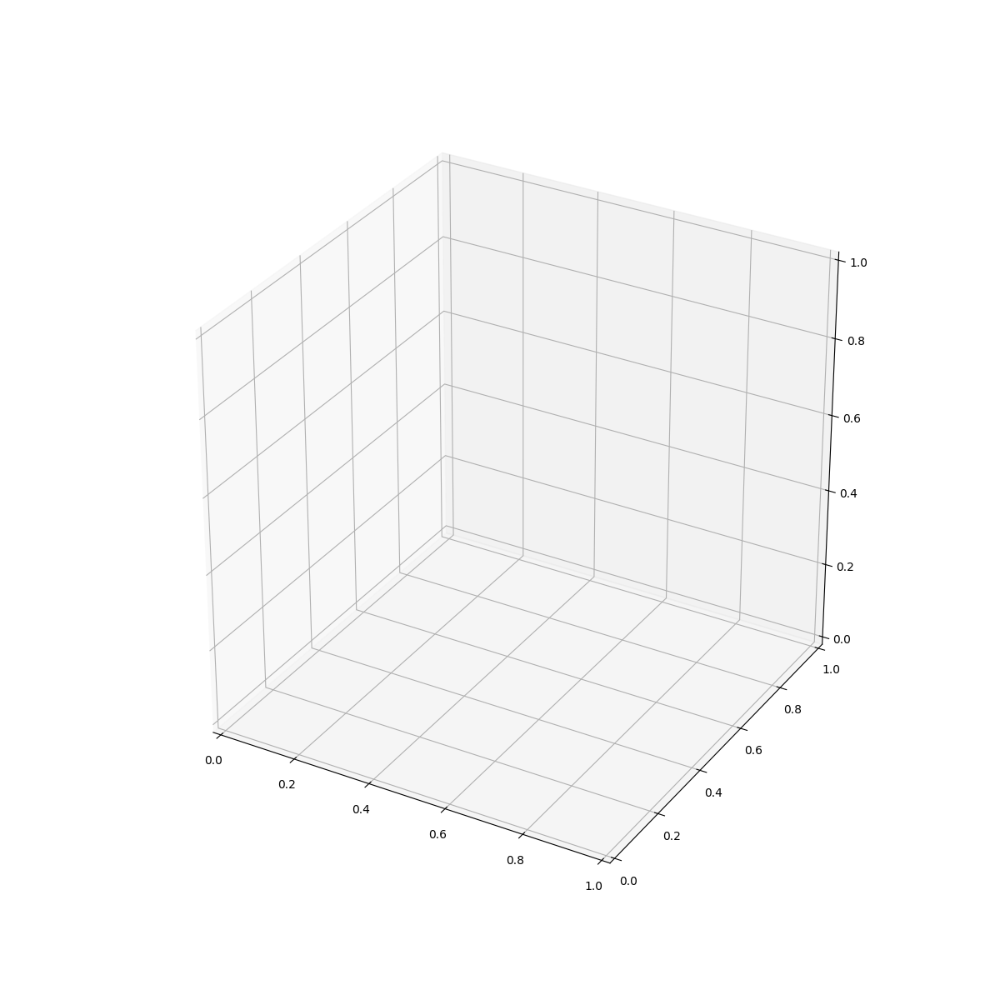

In [108]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc2[::kth,0], 
               content_surface_pc2[::kth,1], 
               content_surface_pc2[::kth,2], c='b', marker='o',s=0.1)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

In [104]:
content_surface_pc2

array([[-0.89181554,  0.0839413 , -0.11316946],
       [ 0.23943833, -0.9487006 , -0.09501945],
       [-1.1533753 , -0.12498701, -0.09832343],
       ...,
       [ 0.63691   ,  0.52253264,  0.02541029],
       [-0.22909772, -1.078356  , -0.0727844 ],
       [ 0.39619818,  0.14115341,  0.19050752]], dtype=float32)

In [107]:
masks[0].shape

(800, 800)

In [ ]:
for iter in range(min(num_viewpoints, len(viewpoint_stack))):
    viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
    render_pkg_cont = render(viewpoint_cam, gaussians, pipe, background)
    image = render_pkg_cont["render"]
    image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)

In [ ]:
sam_result = mask_generator.generate(image_rgb)
masks = [
    mask['segmentation']
    for mask
    in sorted(sam_result, key=lambda x: x['area'], reverse=True)
]
for mask in masks:
    pass
    

In [52]:
np.max(image_rgb)

0.97453266

In [132]:
def mark_surface_points(viewpoint_stack, gaussians, pipe, background, surface_points, num_viewpoints=1, verbose=False):
    # Pseudocode.
    # Prerequisites: gaussians with a scene, surface_points. 
    # 1. Iterate over randomly sampled viewpoints
    #    2. For each new camera viewpoint. Render image_rgb and render image_rgb_as_coords (where we turn color into coordinates)
    #    3. Apply sam to get masks.  
    #    4. Use masks to extract areas from image_rgb_as_coords. Now those values can be used as actual points. 
    #    5. For those points find nearest neighbor in surface_points.
    #    6. As a temporary debug step assign to the point from the surface_points cluster number. 
    import numpy as np
    import skimage.measure, skimage.morphology
    import scipy
    from scipy.spatial import distance


    gaussians_features_dc_original = gaussians._features_dc.detach().clone()
    gaussians_features_rest_original = gaussians._features_rest.detach().clone()
    gaussians_scaling_original = gaussians._scaling.detach().clone()
    gaussians_opacity_original = gaussians._opacity.detach().clone()

    N = len(surface_points)
    # Mask for points(don't really need it, only for debug.
    surface_points_masks = np.ones(N, dtype=np.int32)*-1
    # Adjacency matrix for surface points. High value indicate that points have been assigned to the 
    # same segmentation mask using SAM model.
    surface_points_A = np.zeros((N,N), dtype=np.int32)
    surface_points_masks_list = []
    
    
    for iter in tqdm(range(min(num_viewpoints, len(viewpoint_stack)))):
        surface_points_masks = np.ones(N, dtype=np.int32)*-1
        
        # 2. For each new camera viewpoint. Render image_rgb and render image_rgb_as_coords (where we turn color into coordinates)
        viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
        render_pkg = render(viewpoint_cam, gaussians, pipe, background)
        image = render_pkg["render"]
        image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
        if verbose:
            plt.figure()
            plt.imshow(image_rgb)
            plt.show(block=False)

        # now render rgb_as_coords
        gaussians._opacity.data +=  1e6
        gaussians._features_dc.data = gaussians._xyz.data.clone().detach().unsqueeze(1)
        gaussians._features_rest.data = gaussians._features_rest.data * 0.
        gaussians._scaling.data *=  .98
        render_pkg = render(viewpoint_cam, gaussians, pipe, background)
        image = render_pkg["render"]
        image_rgb_as_coords = image.detach().cpu().numpy().transpose(1, 2, 0)

        if verbose:
            plt.figure()
            plt.imshow(image_rgb_as_coords)
            plt.show(block=False)
        
        # Now recover original _opacity, _scaling, _features_dc, _features_rest.
        gaussians._features_dc.data = gaussians_features_dc_original.detach().clone()
        gaussians._features_rest.data = gaussians_features_rest_original.detach().clone()
        gaussians._scaling.data = gaussians_scaling_original.detach().clone()
        gaussians._opacity.data = gaussians_opacity_original.detach().clone()

        # 3. Apply sam to get masks.  
        # transform input into uint8
        sam_result = mask_generator.generate(np.clip(image_rgb*255., 0., 255.).astype(np.uint8))
        masks = [
            mask['segmentation']
            for mask
            in sorted(sam_result, key=lambda x: x['area'], reverse=False)
        ]
        if verbose:
            detections = sv.Detections.from_sam(sam_result=sam_result)
            image_bgr = (np.array(image_rgb[...,[2,1,0]])*255.).astype(np.uint8)
            annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)
            sv.plot_images_grid(
                images=[image_bgr, annotated_image],
                grid_size=(1, 2),
                titles=['source image', 'segmented image']
            )

        # # 4. Use masks to extract areas from image_rgb_as_coords. Now those values can be used as actual points.
        # #print(len(masks))
        # for mask_idx, mask in tqdm(enumerate(masks)):
        #     mask_points = image_rgb_as_coords[np.where(mask)]
        #     # 5. For those points find nearest neighbor in surface_points.
        #     print("len(mask_points):", len(mask_points))
        #     print("mask_points[:30]:", mask_points[:30])

        #     # CPU Version - pretty slow for large arrays
        #     # pairwise_distances = distance.cdist(mask_points, surface_points, 'euclidean')
        #     # surface_points_nearest_idcs_to_mask = np.argmin(pairwise_distances, axis=1)
        #     # GPU version
        #     pairwise_distances = torch.cdist(
        #         torch.tensor(surface_points).to(device=device).to(dtype=torch.float16),
        #         torch.tensor(mask_points).to(device=device).to(dtype=torch.float16),  
        #         p=2)
        #     surface_points_nearest_idcs_to_mask = torch.argmin(pairwise_distances, axis=1)
        #     surface_points_nearest_idcs_to_mask = surface_points_nearest_idcs_to_mask.detach().cpu().numpy()
            
        #     surface_points_masks[surface_points_nearest_idcs_to_mask] = mask_idx

        # Do it a bit differently

        #print(len(masks))
        masks_points_coords = []
        masks_points_labels = []
        for mask_idx, mask in tqdm(enumerate(masks)):
            masks_points_coords.append(image_rgb_as_coords[np.where(mask)])
            masks_points_labels.append(np.ones(len(masks_points_coords[-1]))*mask_idx)

        # Subsample and get 100K points
        masks_points_coords = np.concatenate(masks_points_coords, axis=0)
        masks_points_labels = np.concatenate(masks_points_labels, axis=0)

        idcs = np.random.choice(range(len(masks_points_coords)), size=100_000, replace=False) 
        masks_points_coords = masks_points_coords[idcs]
        masks_points_labels = masks_points_labels[idcs]

        # For each surface point find the nearest SAM mask point and assign its label if the 
        # distance is smaller then some threshold.
        # CPU Version - pretty slow for large arrays
        # pairwise_distances = distance.cdist(mask_points, surface_points, 'euclidean')
        # surface_points_nearest_idcs_to_mask = np.argmin(pairwise_distances, axis=1)
        # GPU version
        pairwise_distances = torch.cdist(
            torch.tensor(surface_points).to(device=device).to(dtype=torch.float16),
            torch.tensor(masks_points_coords).to(device=device).to(dtype=torch.float16),  
            p=2)
        surface_points_to_mask_val, surface_points_to_mask_idx = torch.min(pairwise_distances, axis=1)

        
        surface_points_to_mask_val = surface_points_to_mask_val.detach().cpu().numpy()
        surface_points_to_mask_idx = surface_points_to_mask_idx.detach().cpu().numpy()

        
        # surface_points_masks[np.where(surface_points_to_mask_val<THRESH)[0]]
        # surface_points_masks = masks_points_labels[surface_points_to_mask_idx]

        # Find surface points that are close enough (closer then threshold)
        THRESH = 2e-2
        relevant_surface_points_idcs = np.where(surface_points_to_mask_val<THRESH)[0]
        surface_points_masks[relevant_surface_points_idcs] = masks_points_labels[surface_points_to_mask_idx][relevant_surface_points_idcs]

        surface_points_masks_list.append(surface_points_masks)
        for mask_val in np.unique(surface_points_masks):
            if mask_val != -1:
                idcs = np.where(surface_points_masks==mask_val)[0]
                surface_points_A[np.ix_(idcs, idcs)] += 1

    return surface_points_A, surface_points_masks_list
        
    #     return surface_points_masks

        
        
    #     return masks_points_coords, masks_points_labels
            
    #     # 5. For those points find nearest neighbor in surface_points.
    #     print("len(mask_points):", len(mask_points))
    #     print("mask_points[:30]:", mask_points[:30])

    #     # CPU Version - pretty slow for large arrays
    #     # pairwise_distances = distance.cdist(mask_points, surface_points, 'euclidean')
    #     # surface_points_nearest_idcs_to_mask = np.argmin(pairwise_distances, axis=1)
    #     # GPU version
    #     pairwise_distances = torch.cdist(
    #         torch.tensor(surface_points).to(device=device).to(dtype=torch.float16),
    #         torch.tensor(mask_points).to(device=device).to(dtype=torch.float16),  
    #         p=2)
    #     surface_points_nearest_idcs_to_mask = torch.argmin(pairwise_distances, axis=1)
    #     surface_points_nearest_idcs_to_mask = surface_points_nearest_idcs_to_mask.detach().cpu().numpy()
        
    #     surface_points_masks[surface_points_nearest_idcs_to_mask] = mask_idx

    #     for mask_val in np.unique(surface_points_masks):
    #         if mask_val != -1:
    #             idcs = np.where(surface_points_masks==mask_val)[0]
    #             surface_points_A[idcs][:,idcs] += 1
    # return surface_points_masks


        
        

        

/tmp/ipykernel_2182930/501886535.py:30: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for iter in tqdm(range(min(num_viewpoints, len(viewpoint_stack)))):


  0%|          | 0/20 [00:00<?, ?it/s]

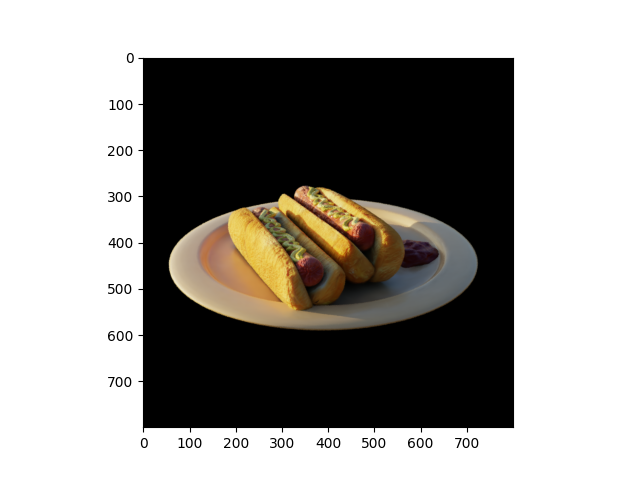

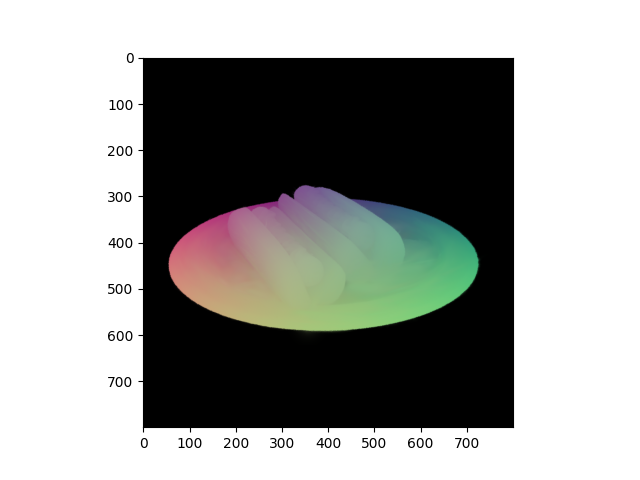

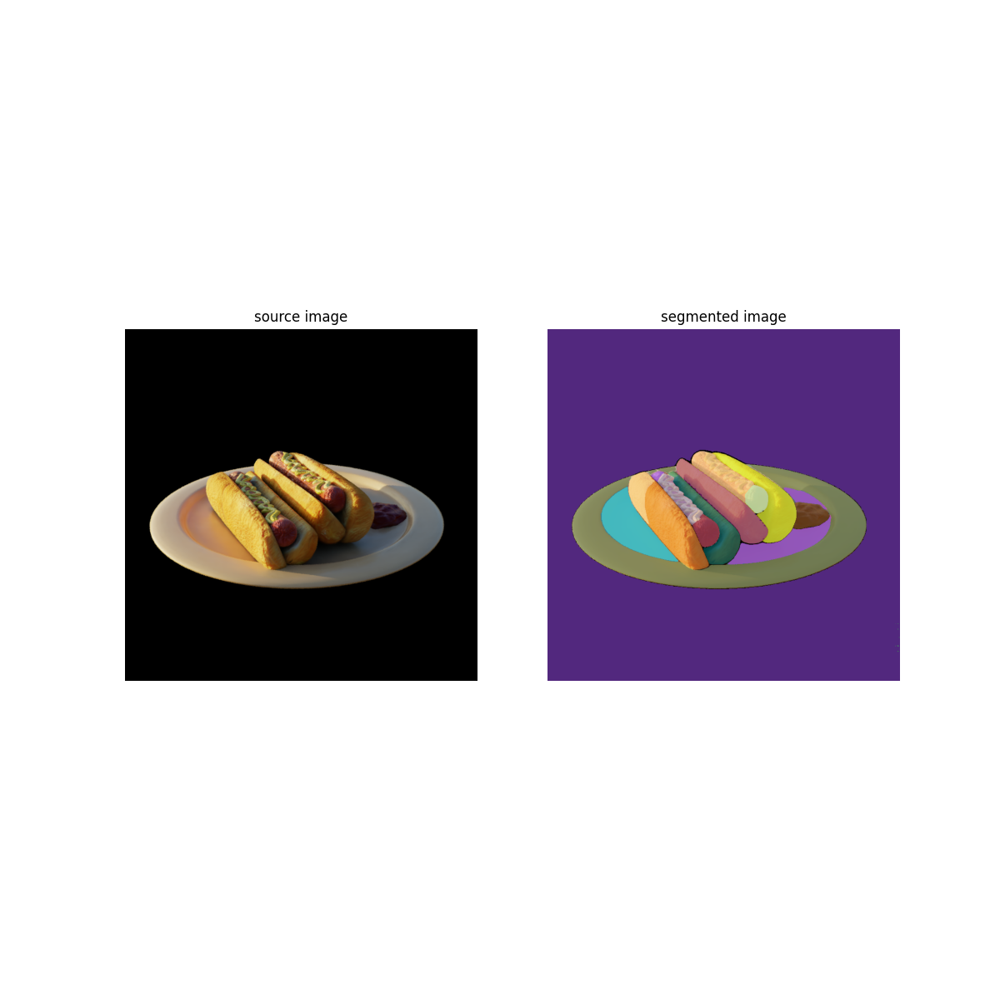

/tmp/ipykernel_2182930/501886535.py:107: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for mask_idx, mask in tqdm(enumerate(masks)):


0it [00:00, ?it/s]

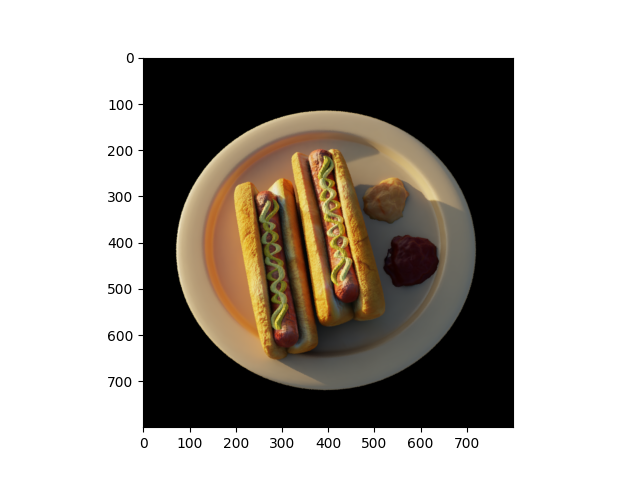

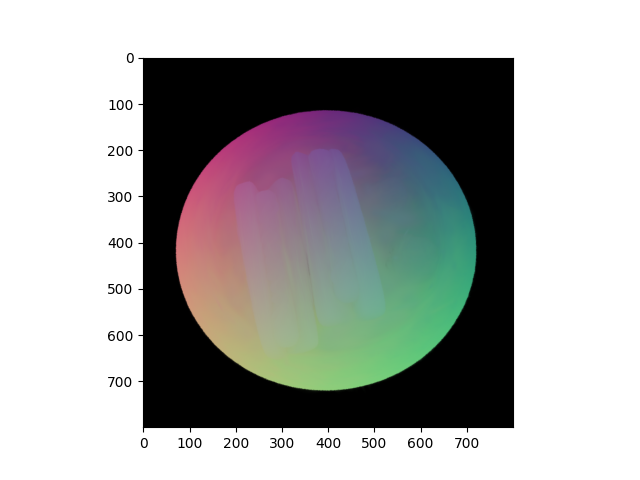

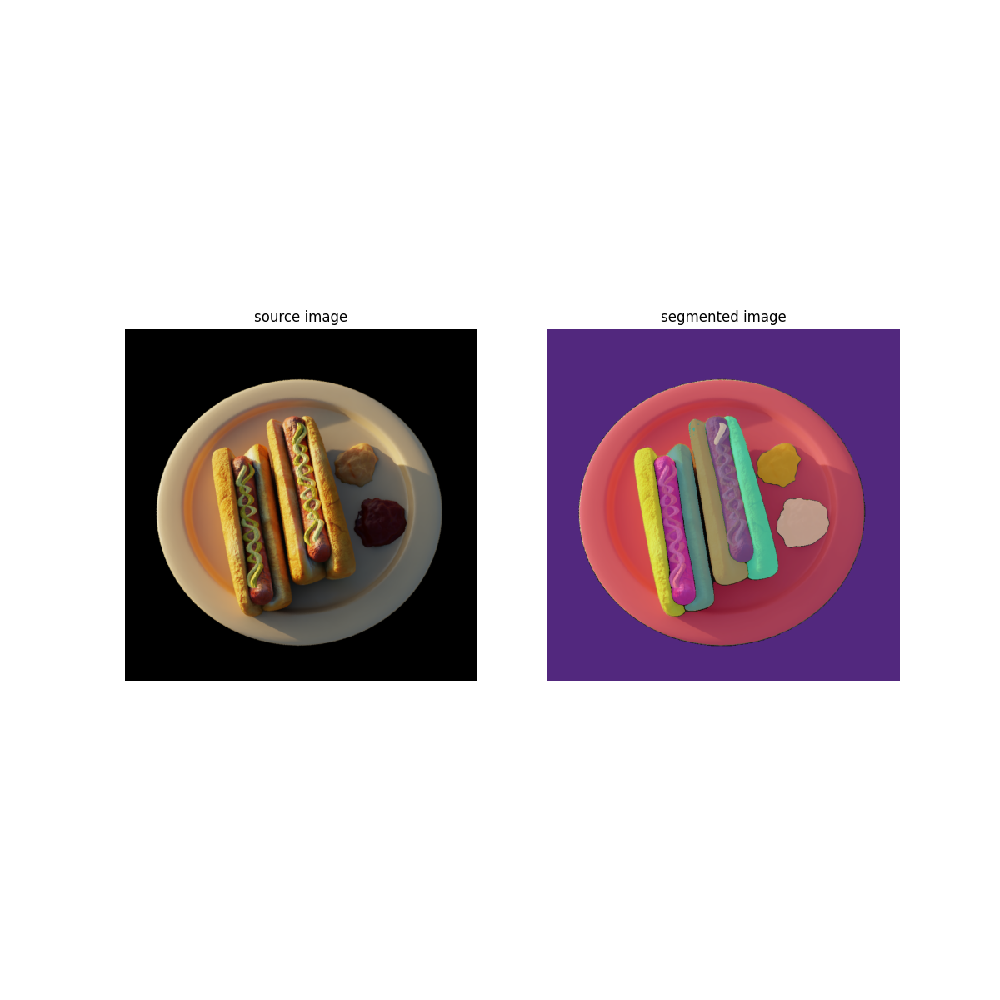

0it [00:00, ?it/s]

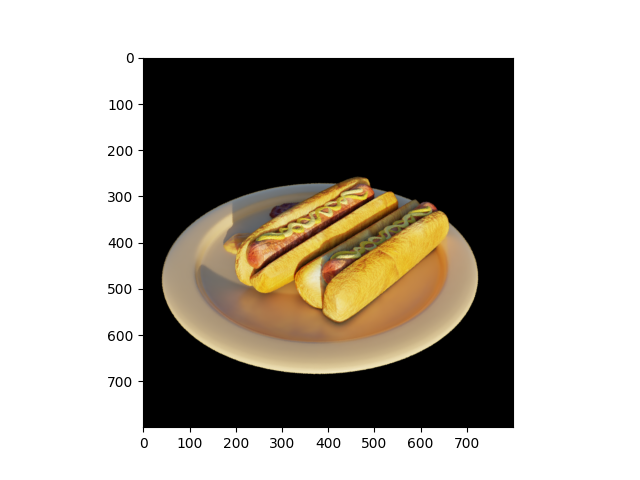

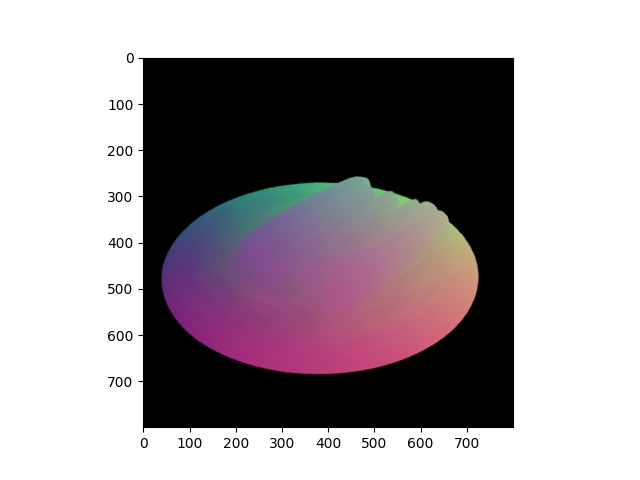

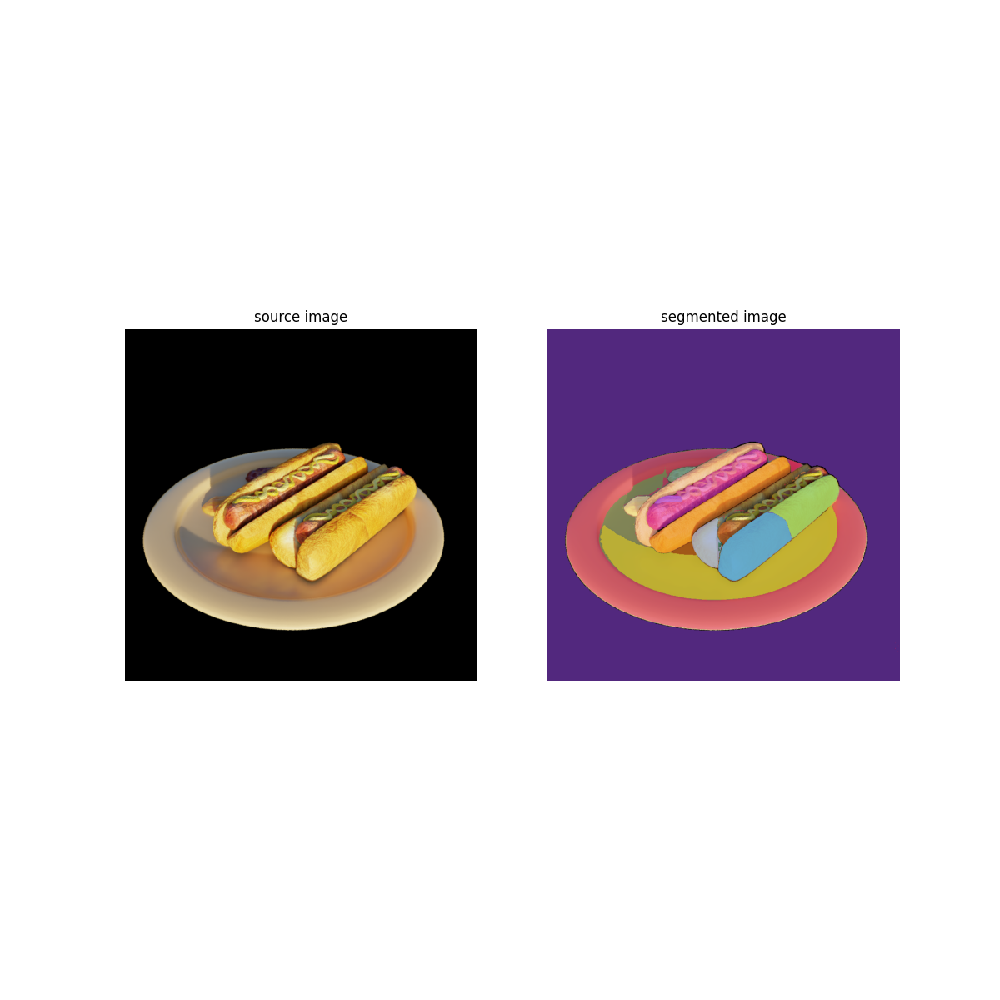

0it [00:00, ?it/s]

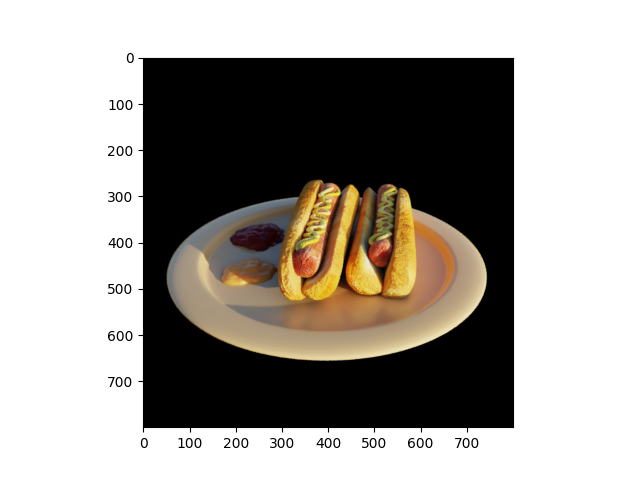

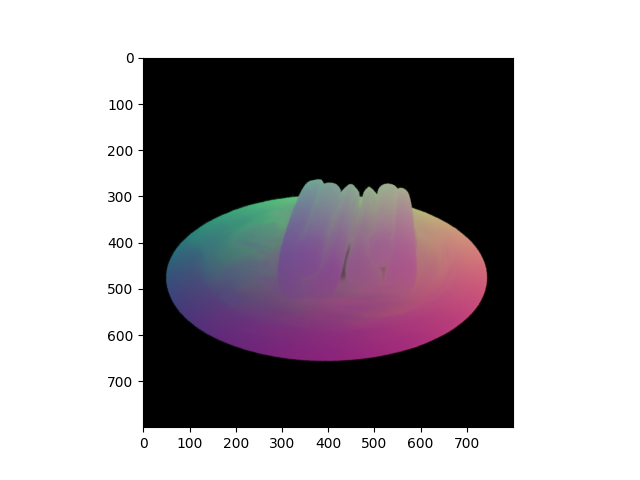

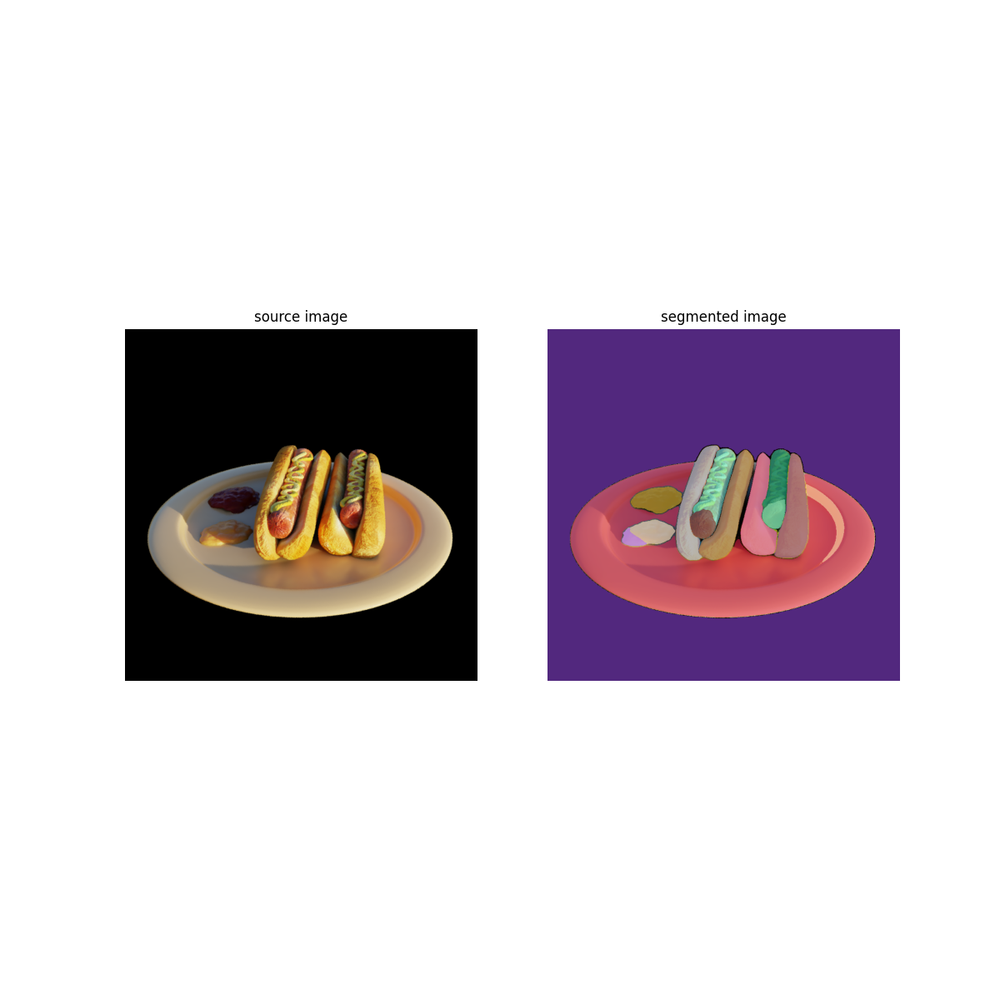

0it [00:00, ?it/s]

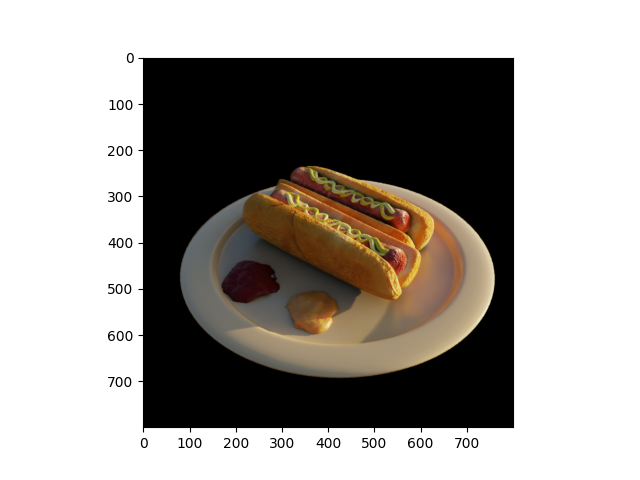

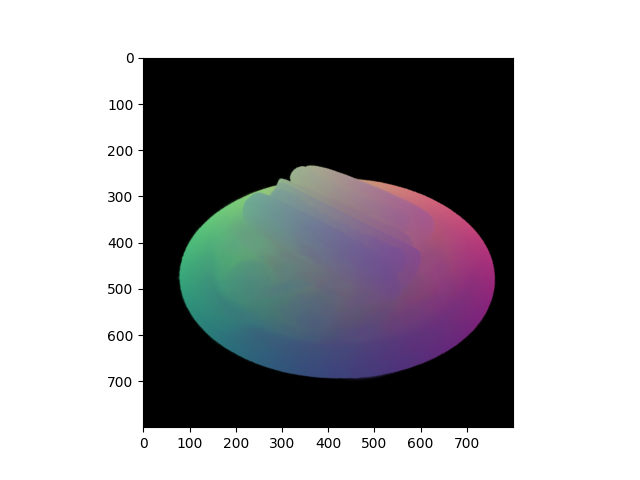

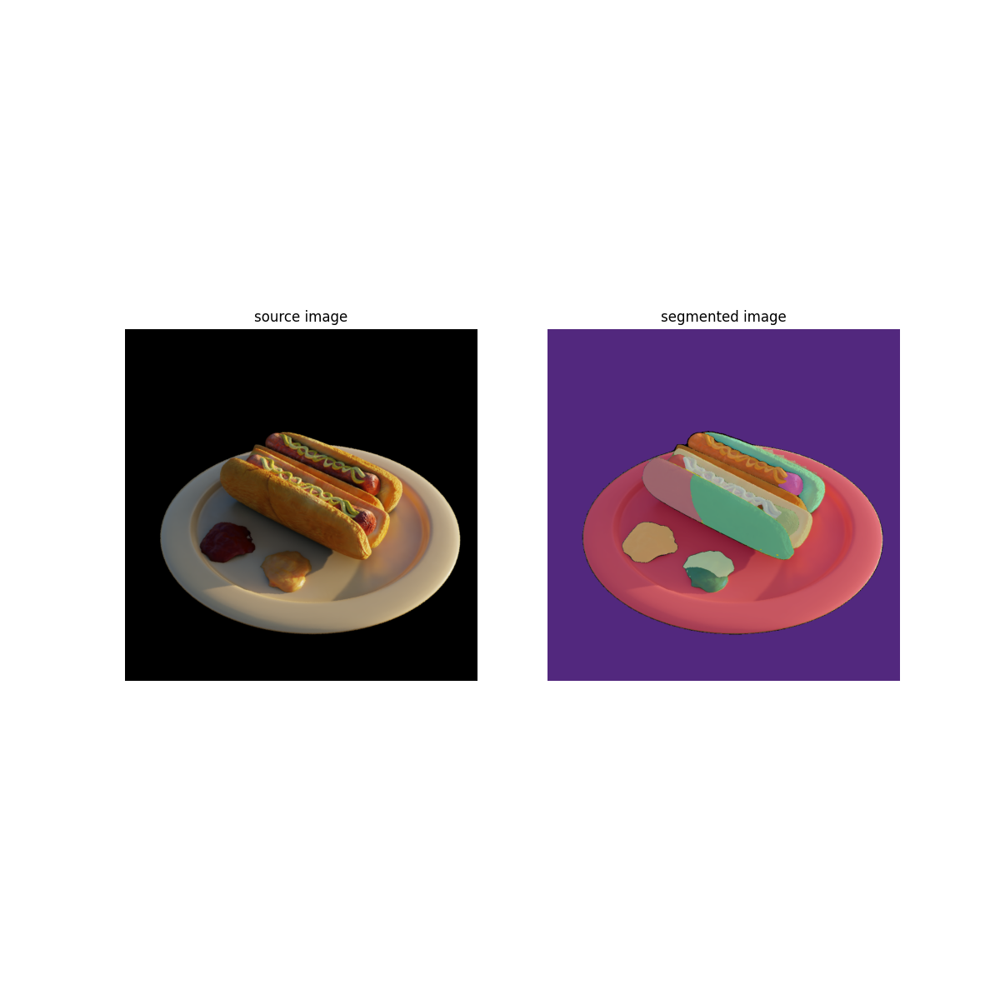

0it [00:00, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


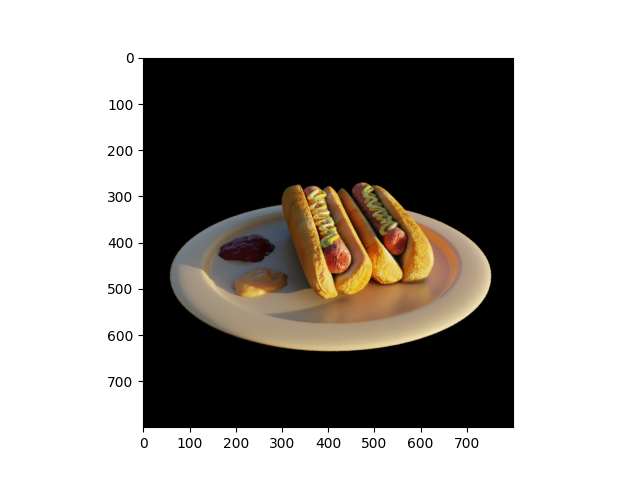

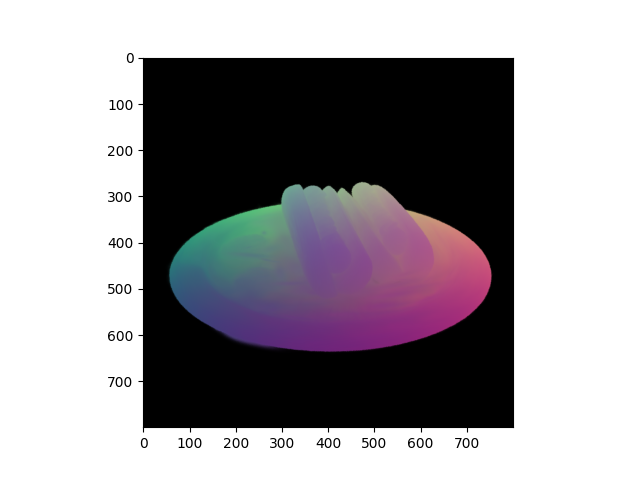

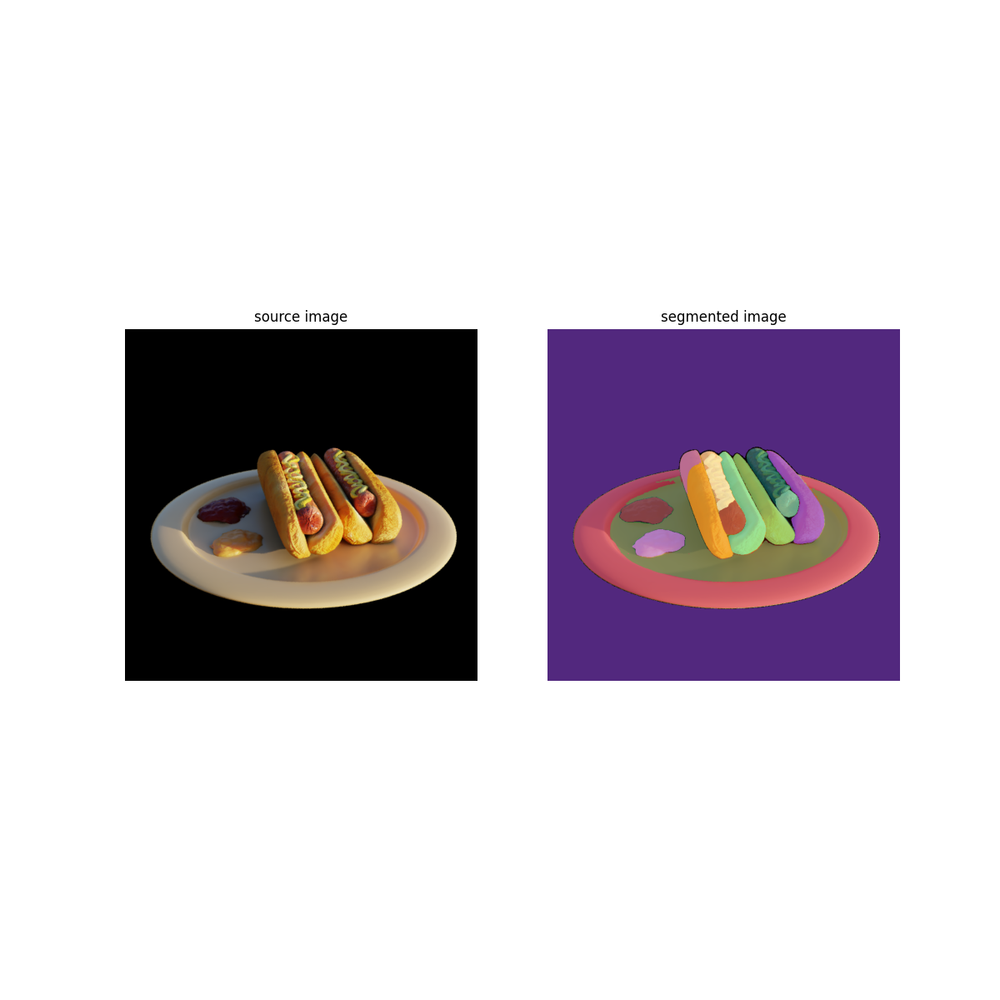

0it [00:00, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


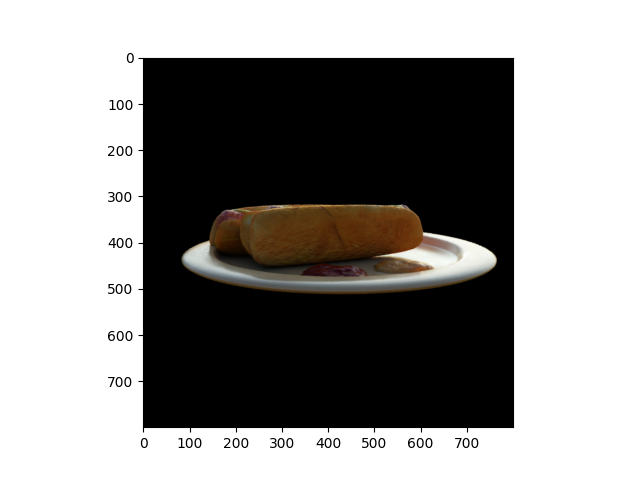

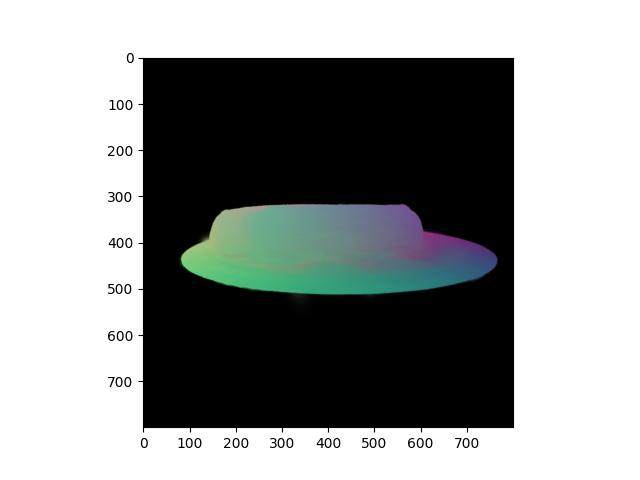

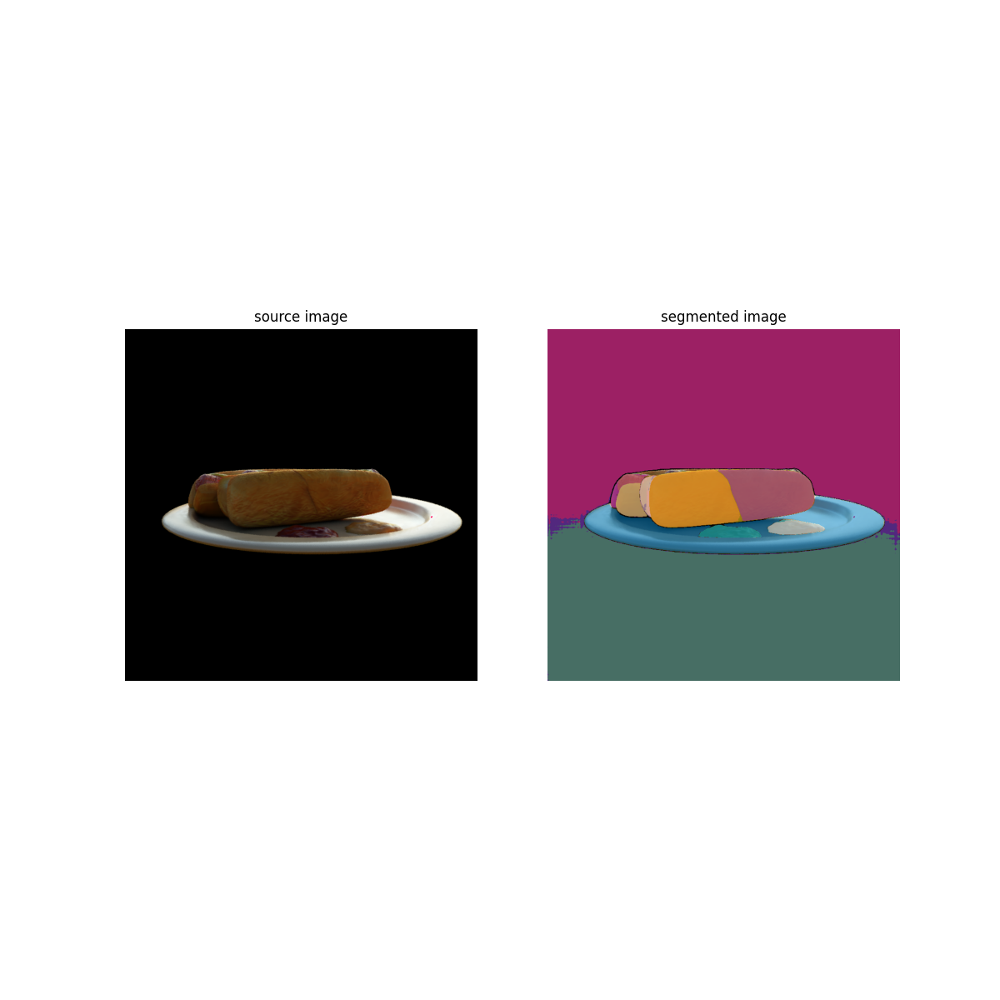

0it [00:00, ?it/s]

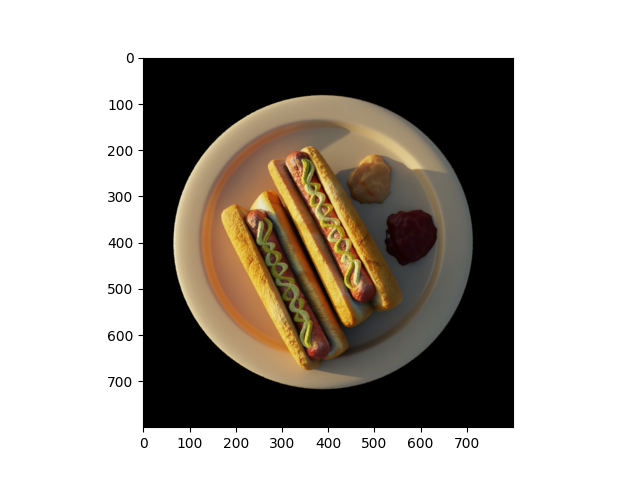

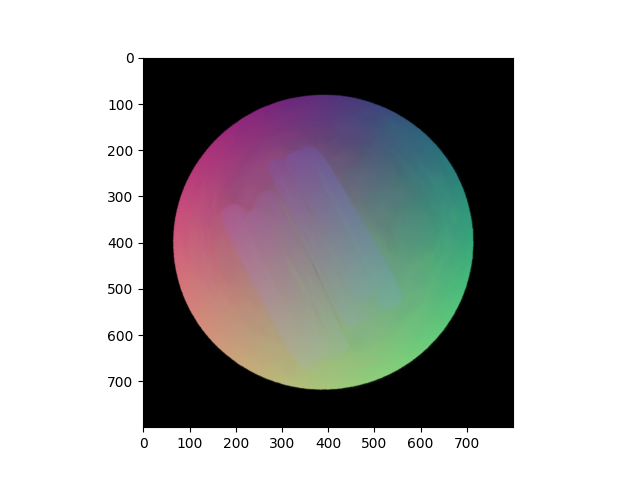

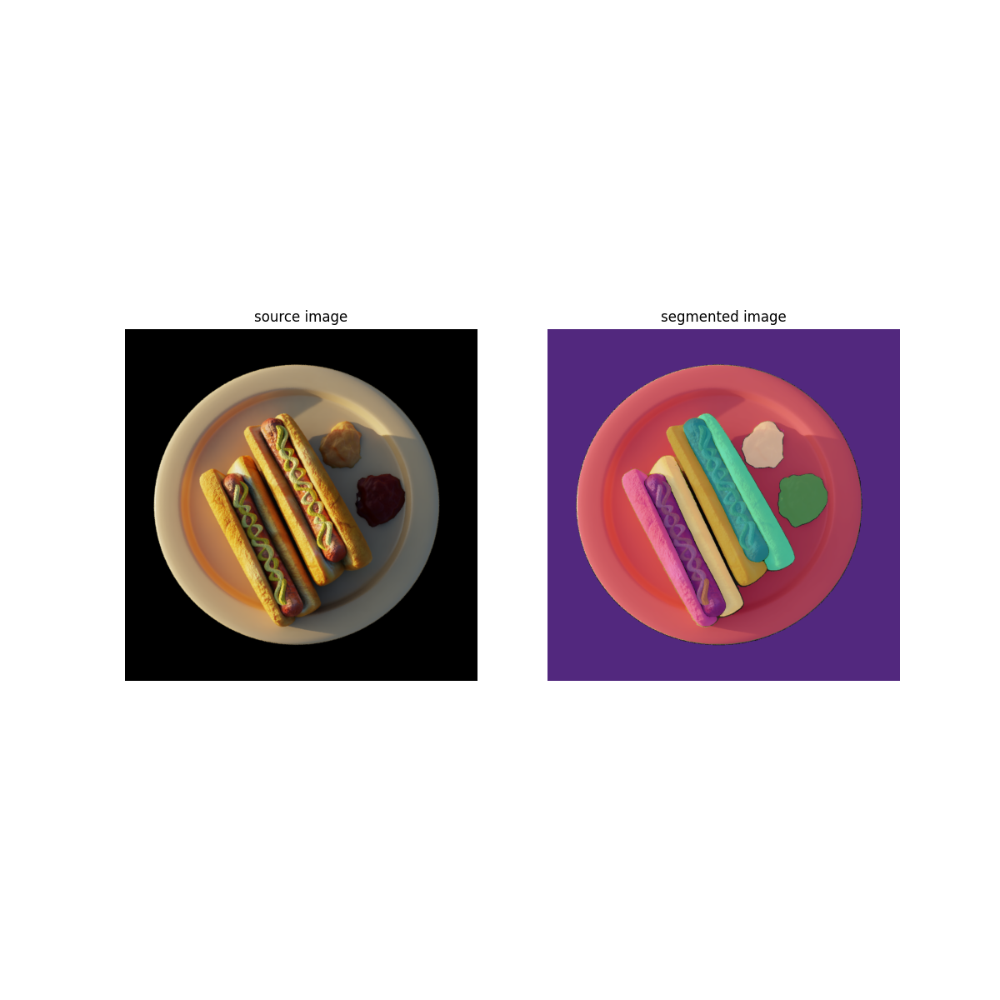

0it [00:00, ?it/s]

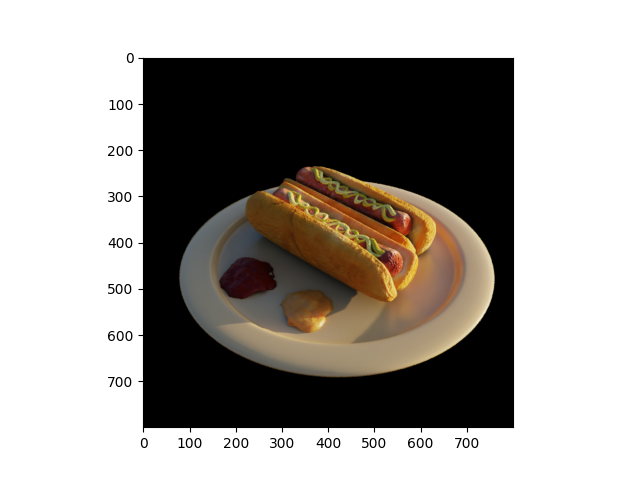

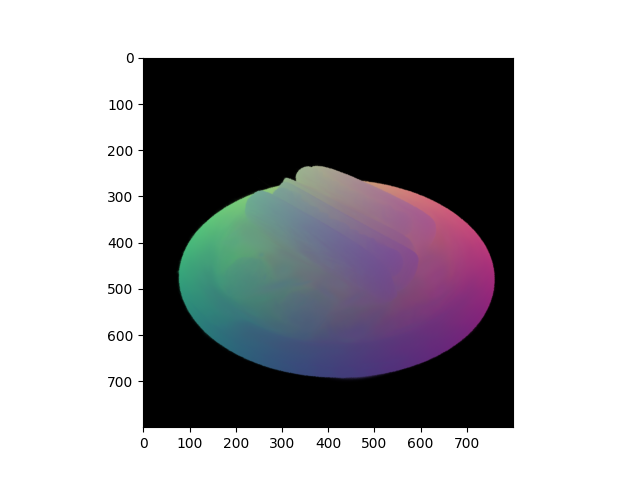

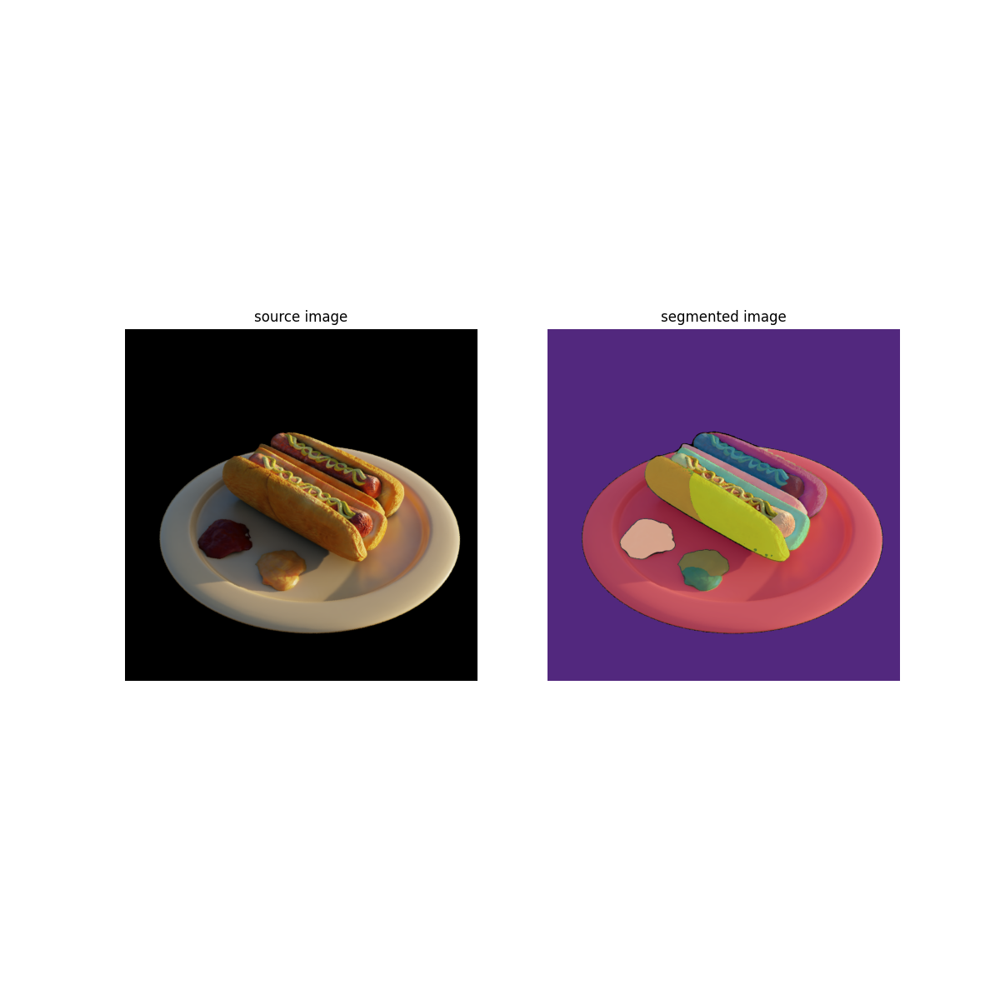

0it [00:00, ?it/s]

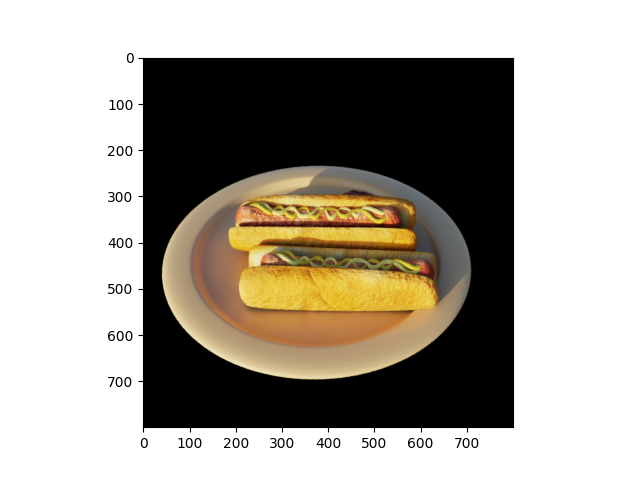

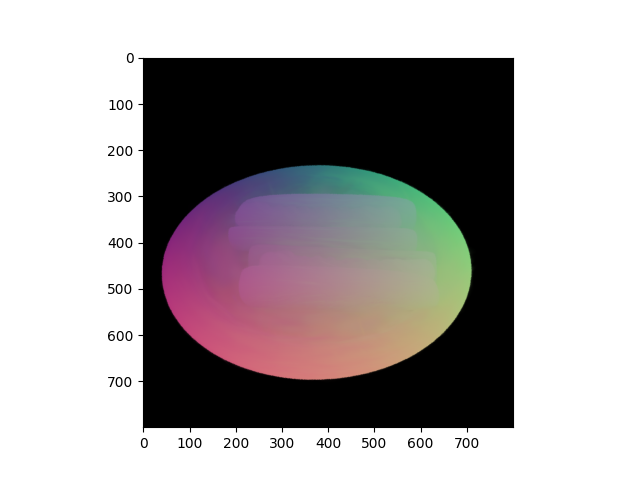

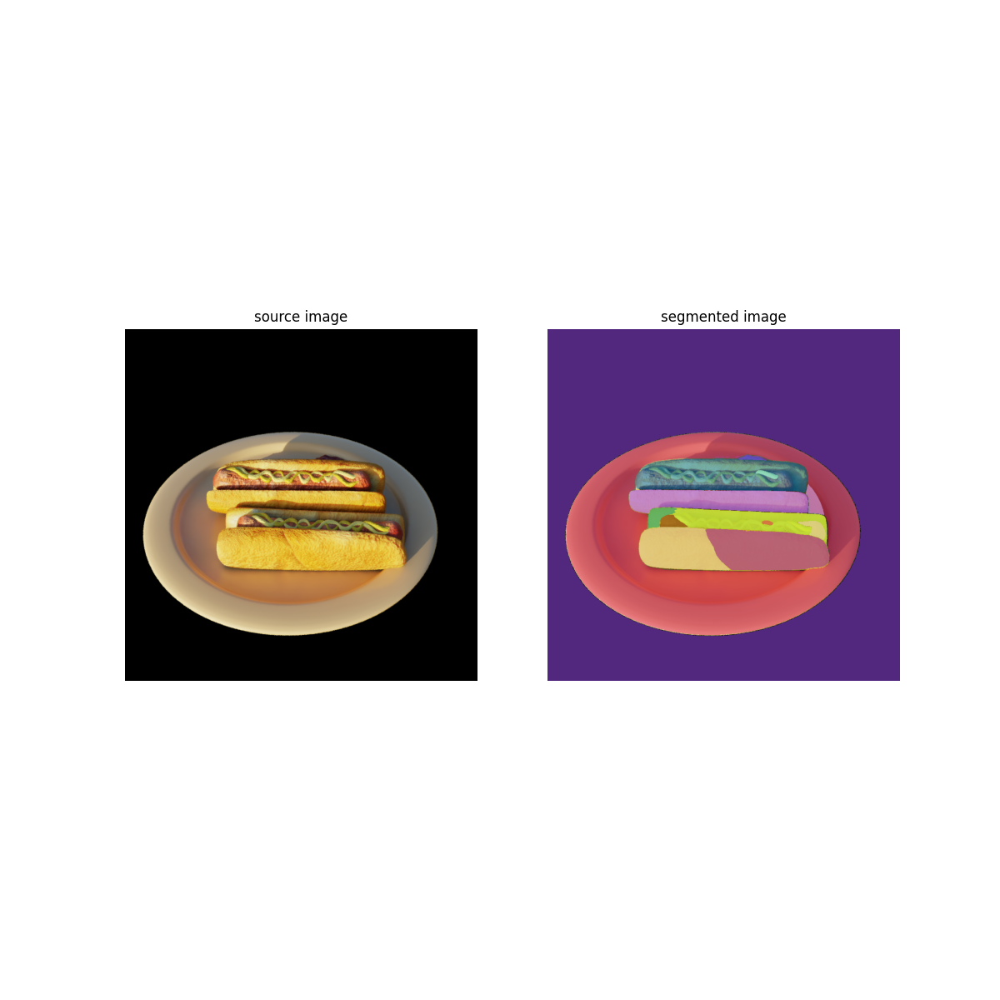

0it [00:00, ?it/s]

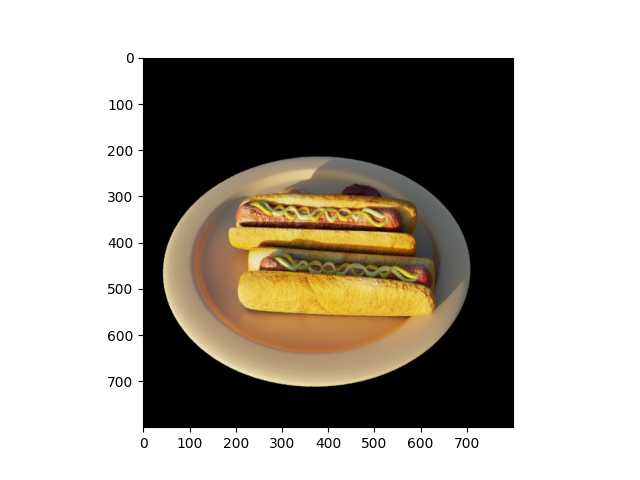

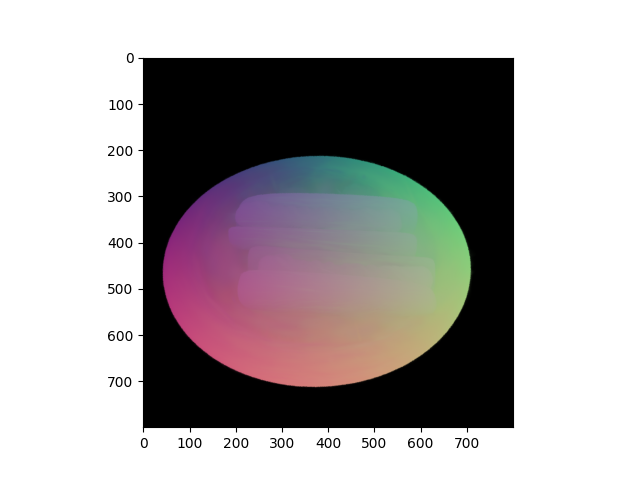

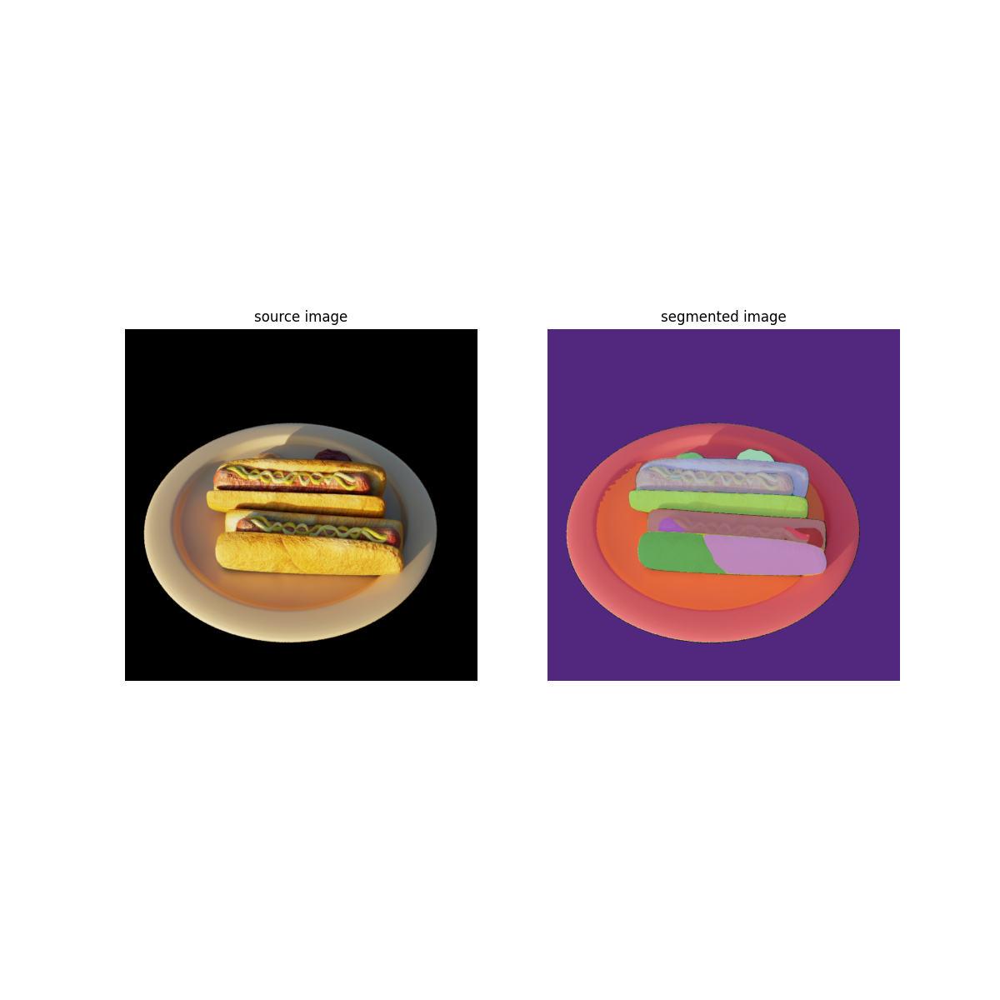

0it [00:00, ?it/s]

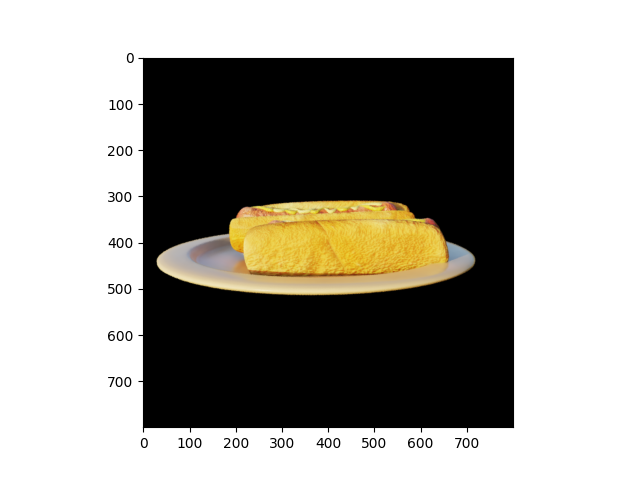

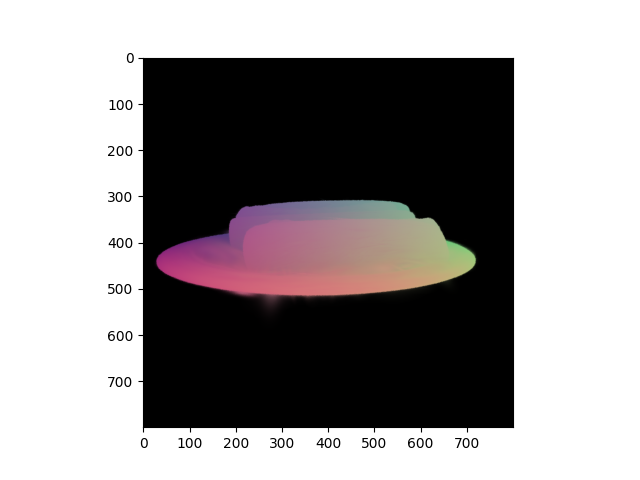

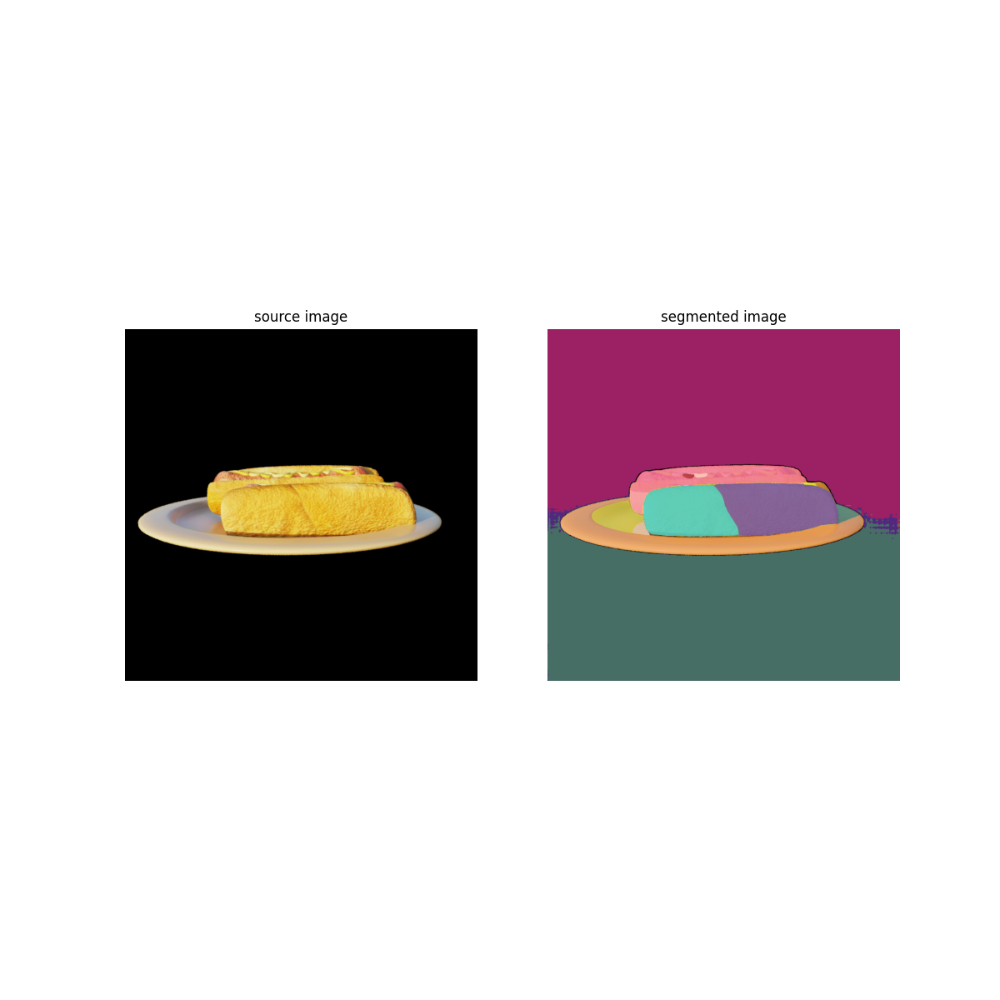

0it [00:00, ?it/s]

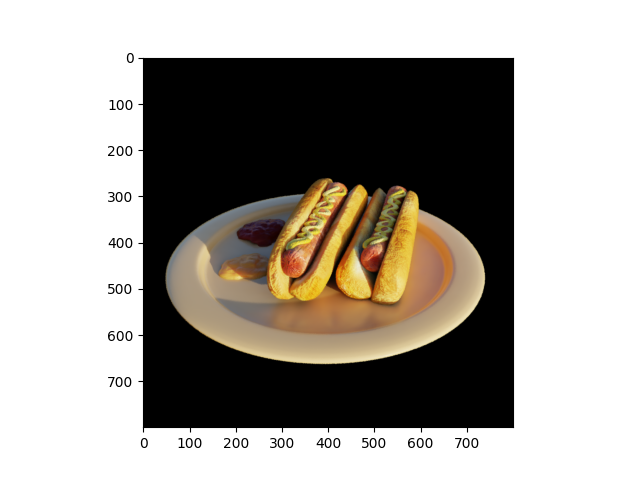

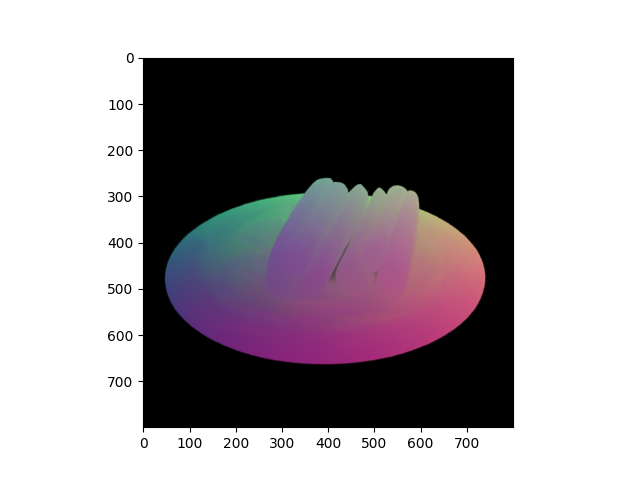

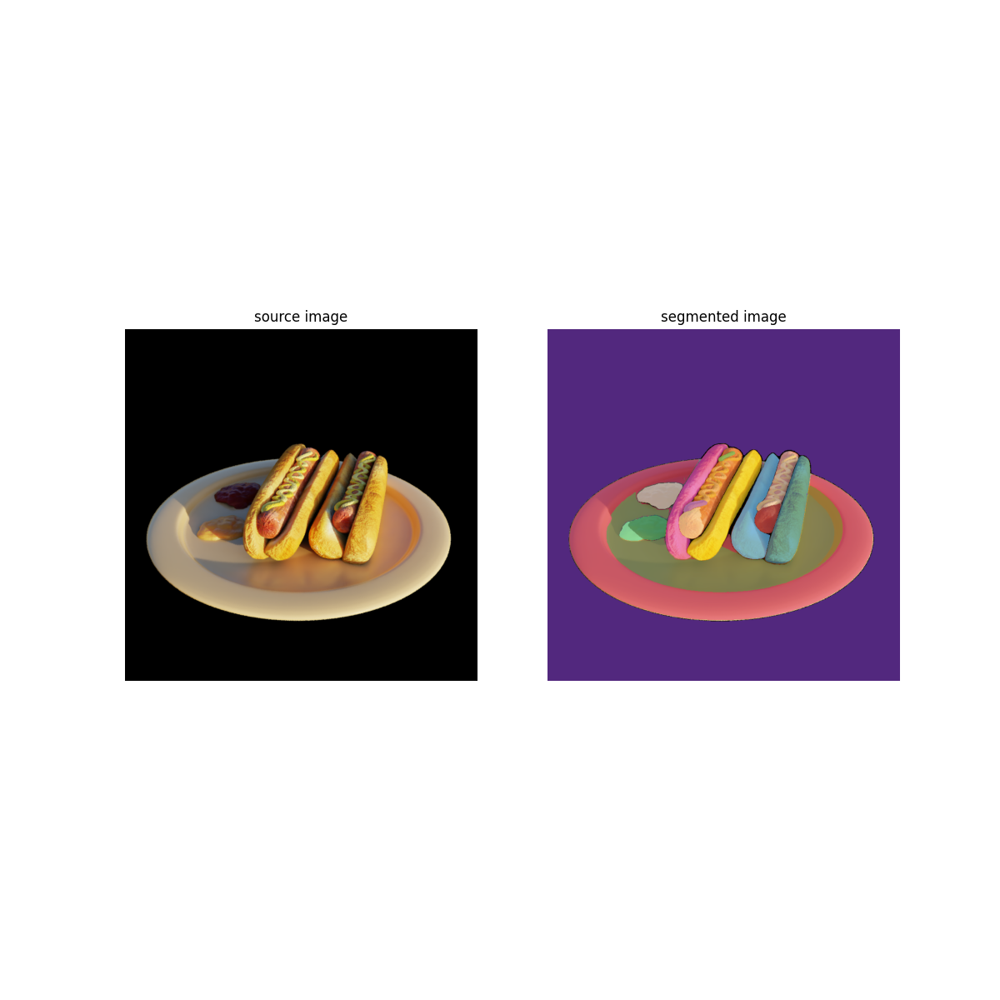

0it [00:00, ?it/s]

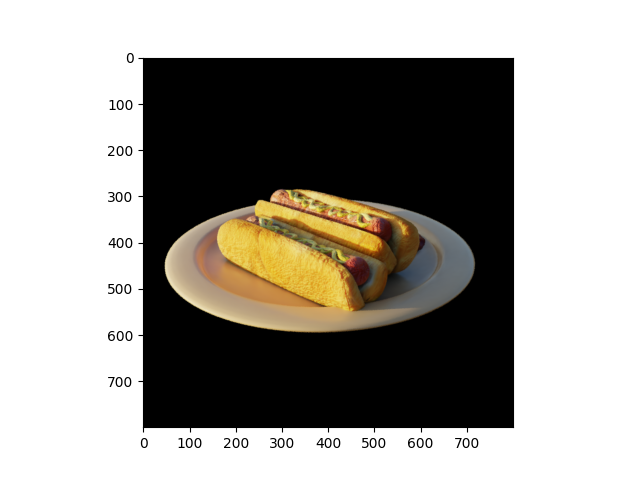

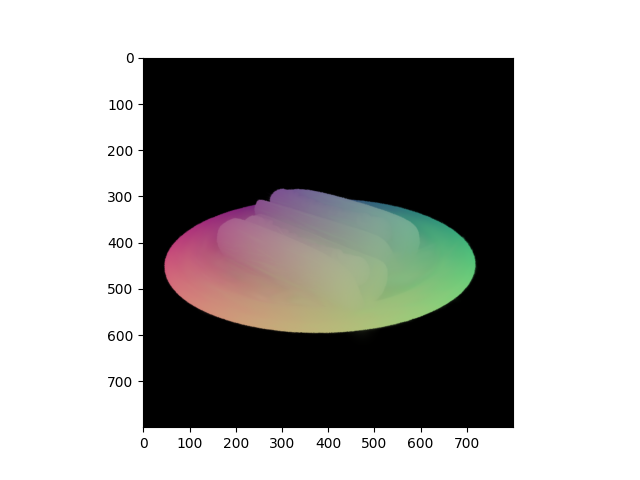

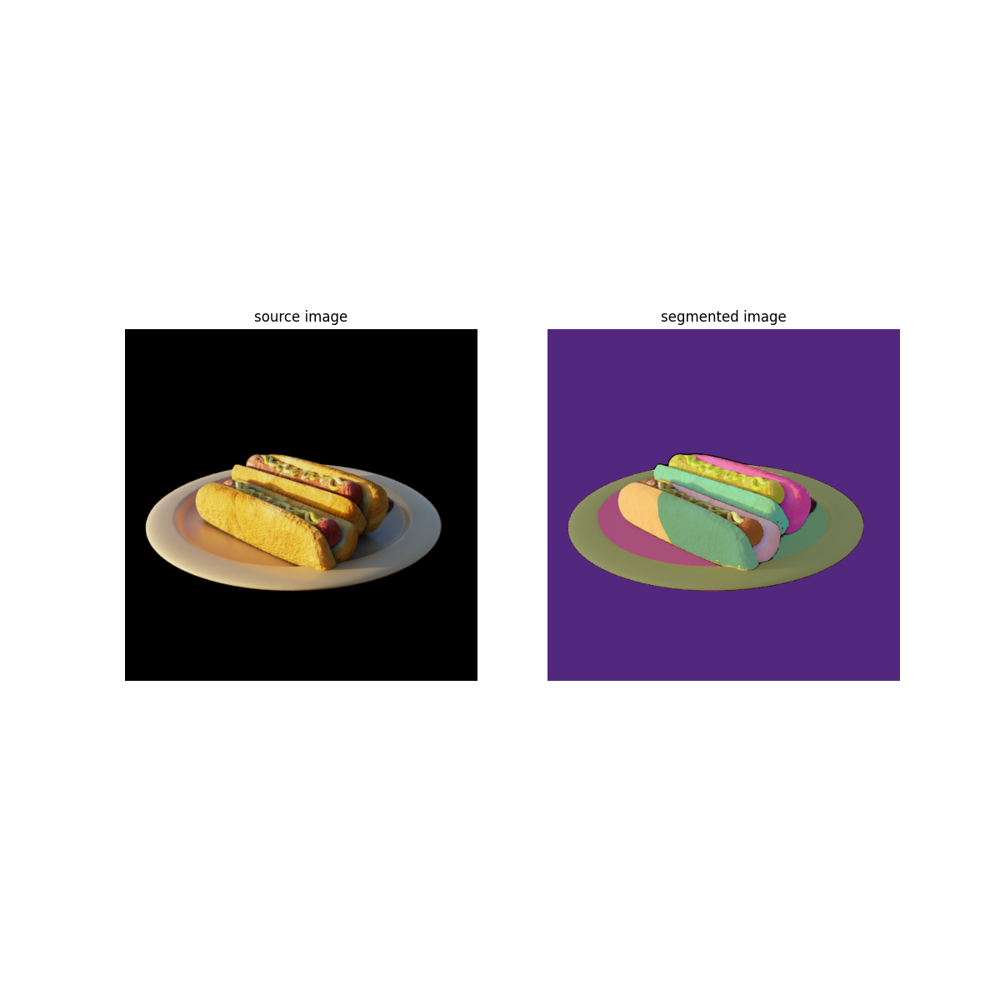

0it [00:00, ?it/s]

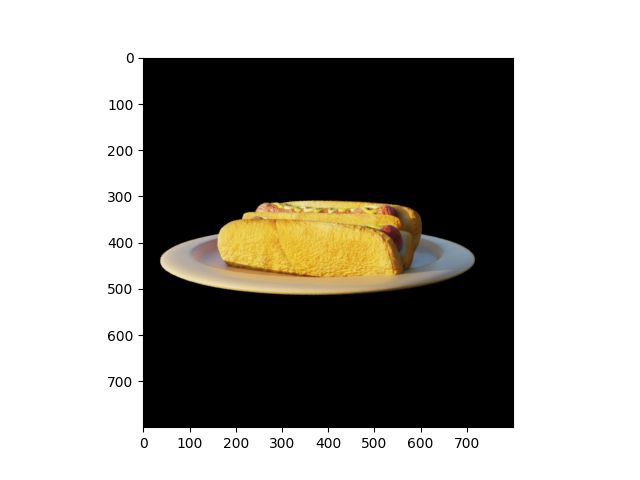

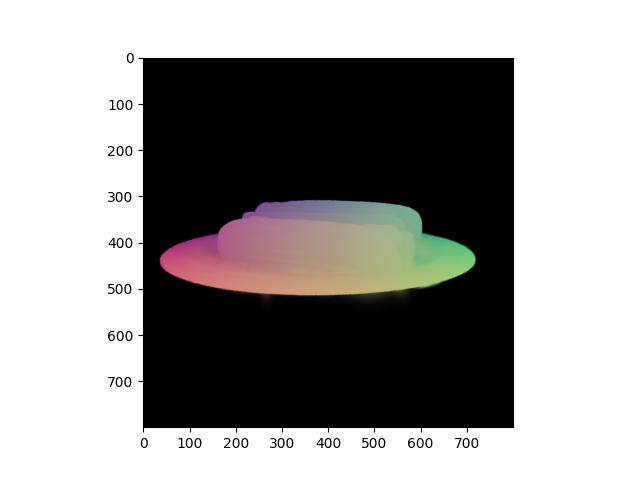

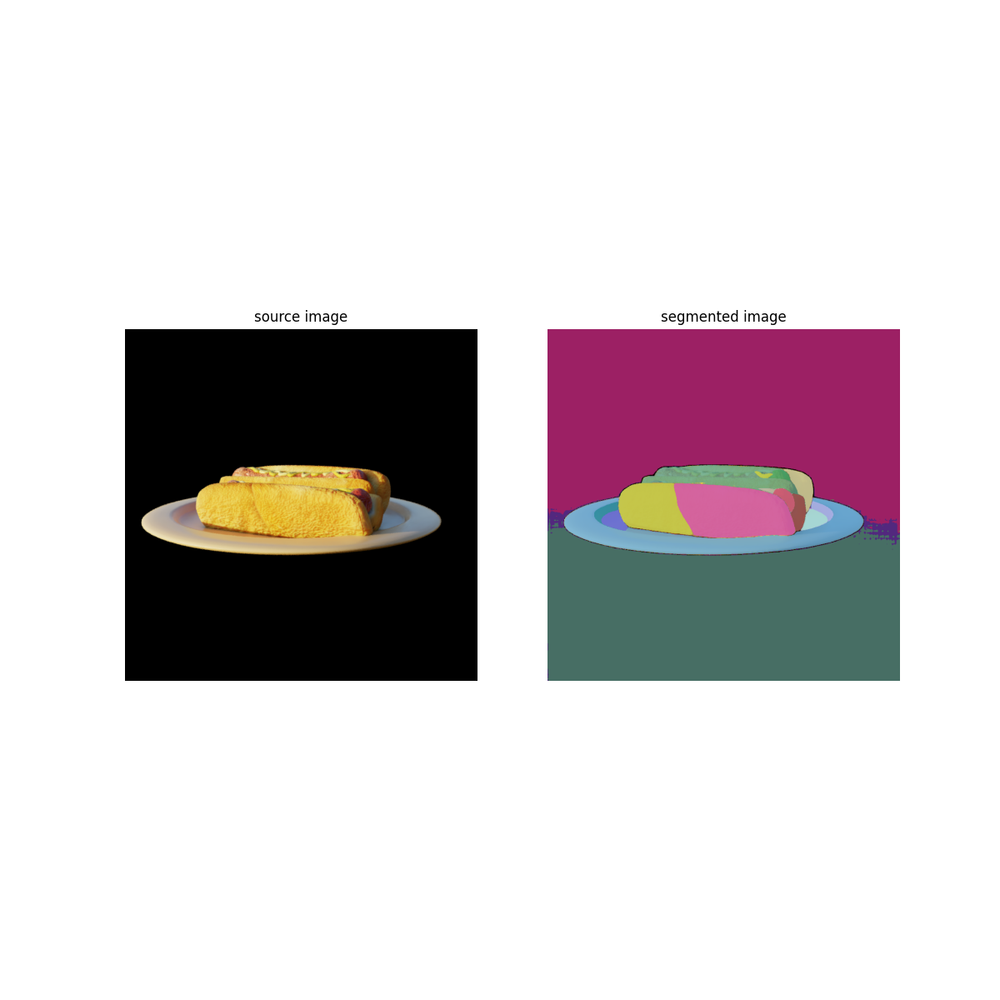

0it [00:00, ?it/s]

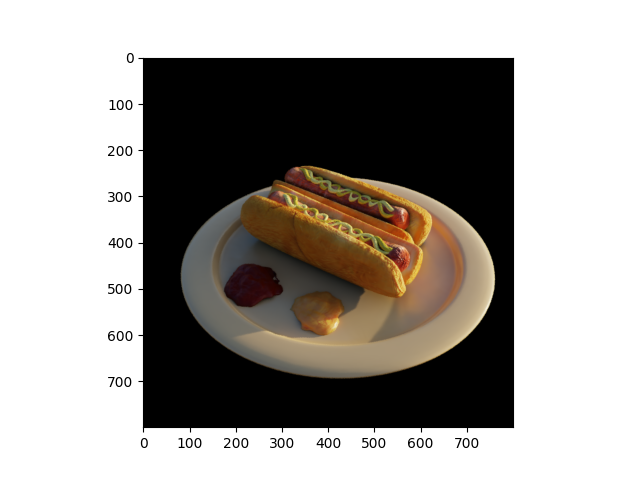

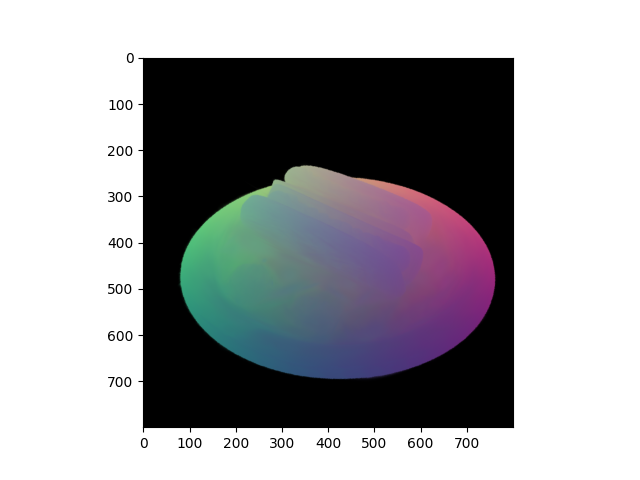

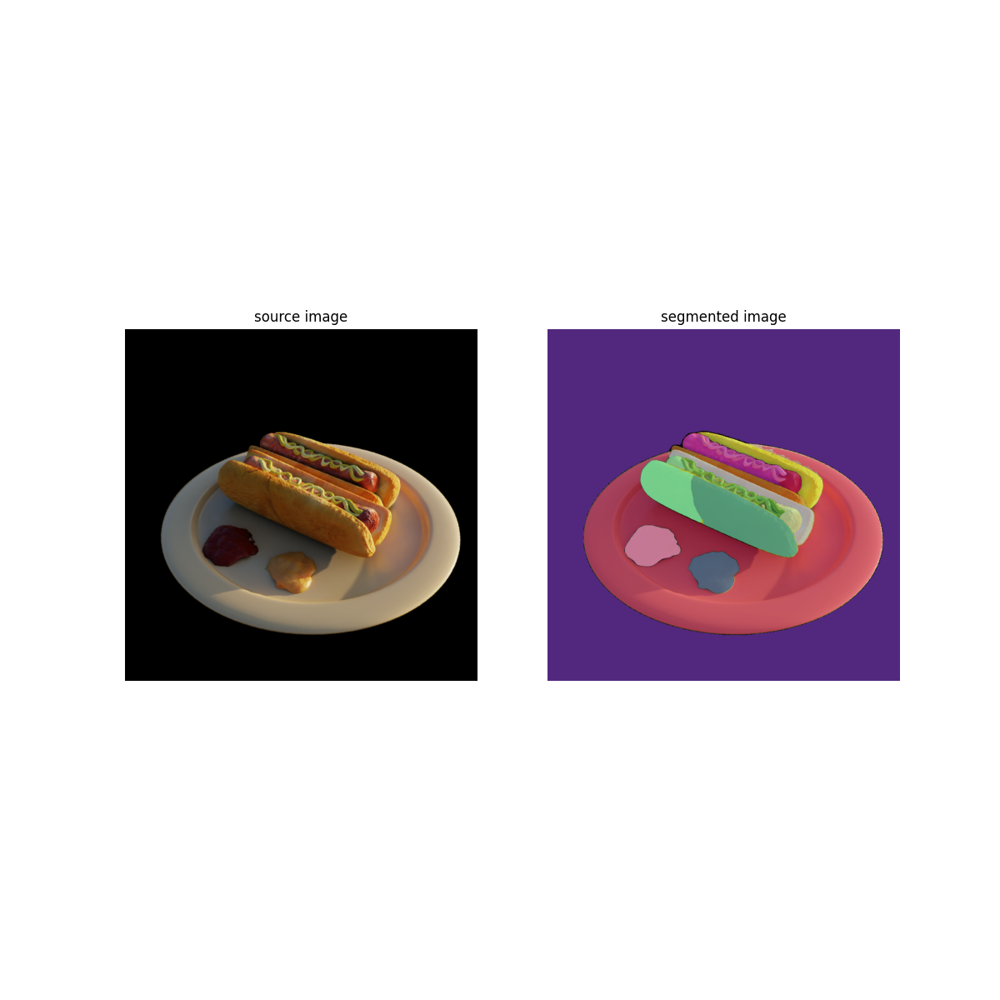

0it [00:00, ?it/s]

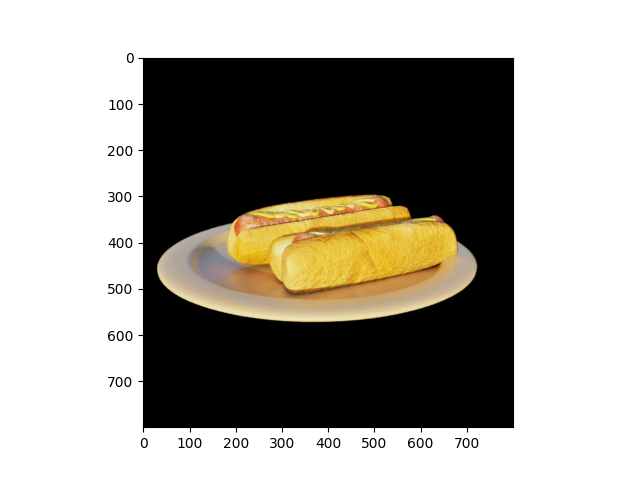

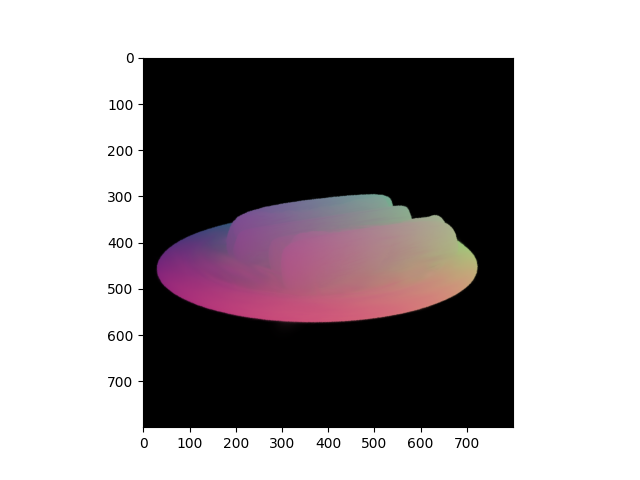

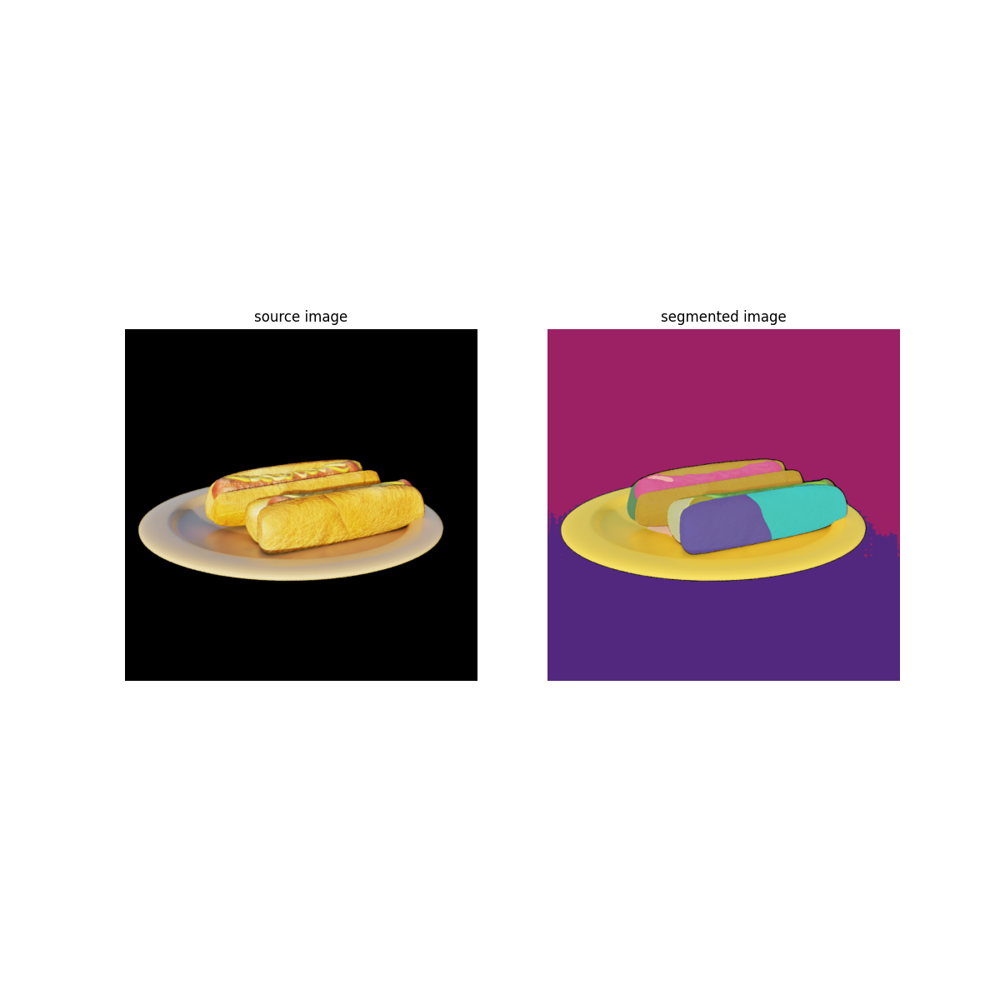

0it [00:00, ?it/s]

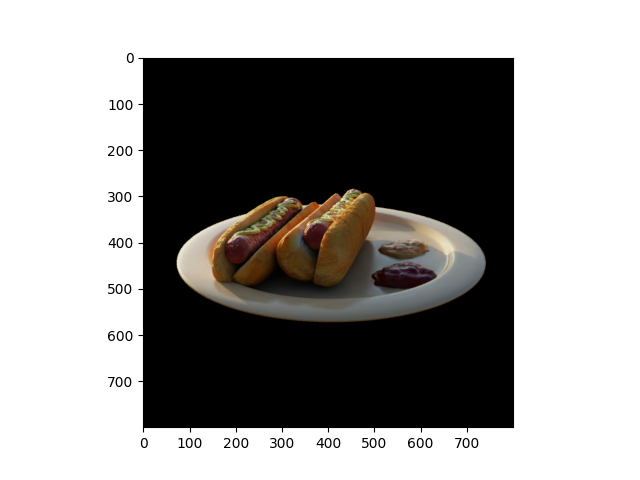

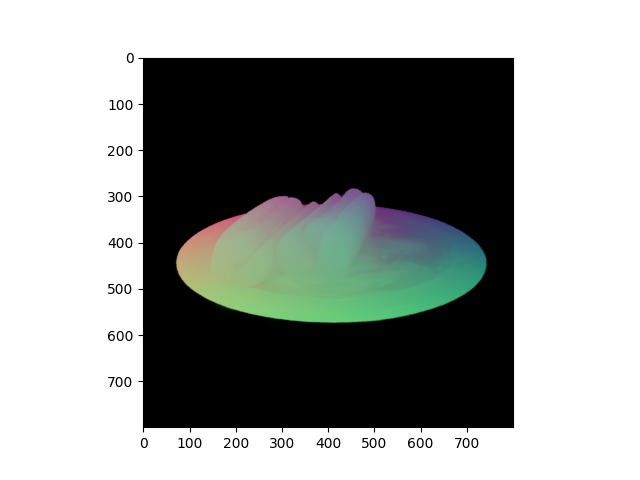

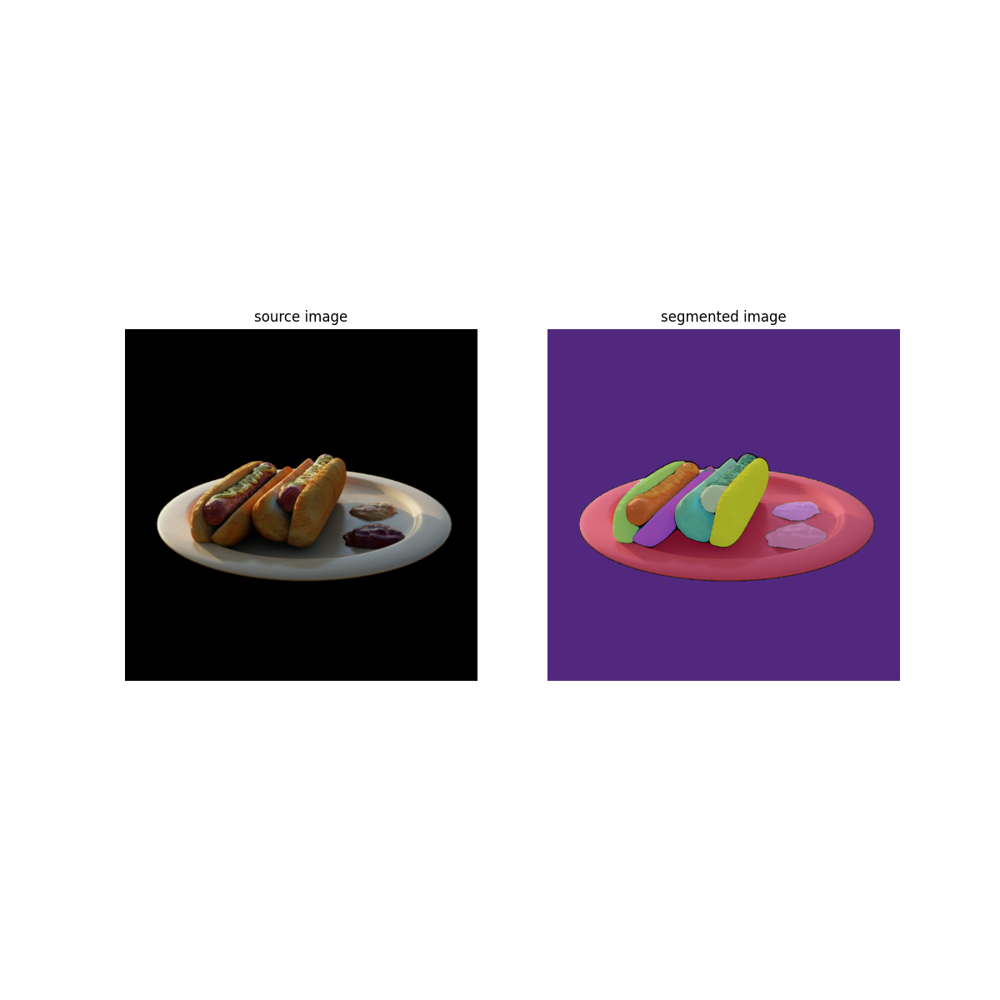

0it [00:00, ?it/s]

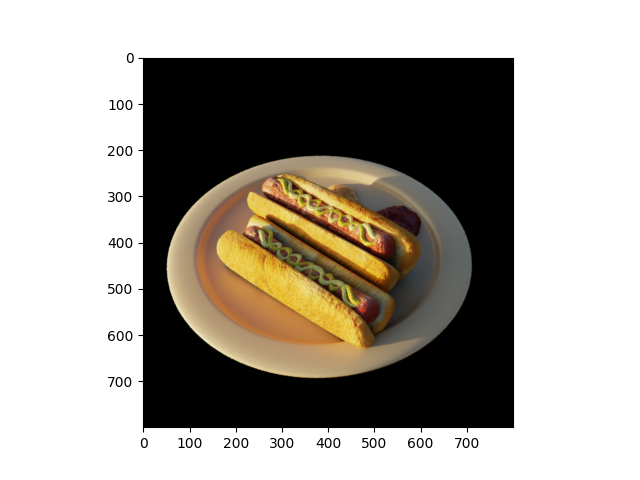

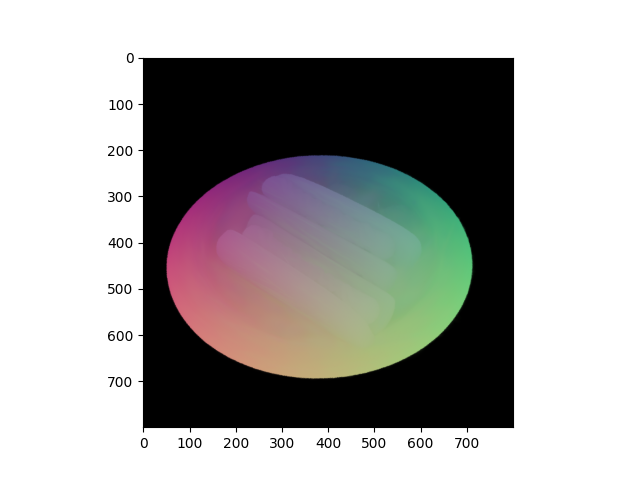

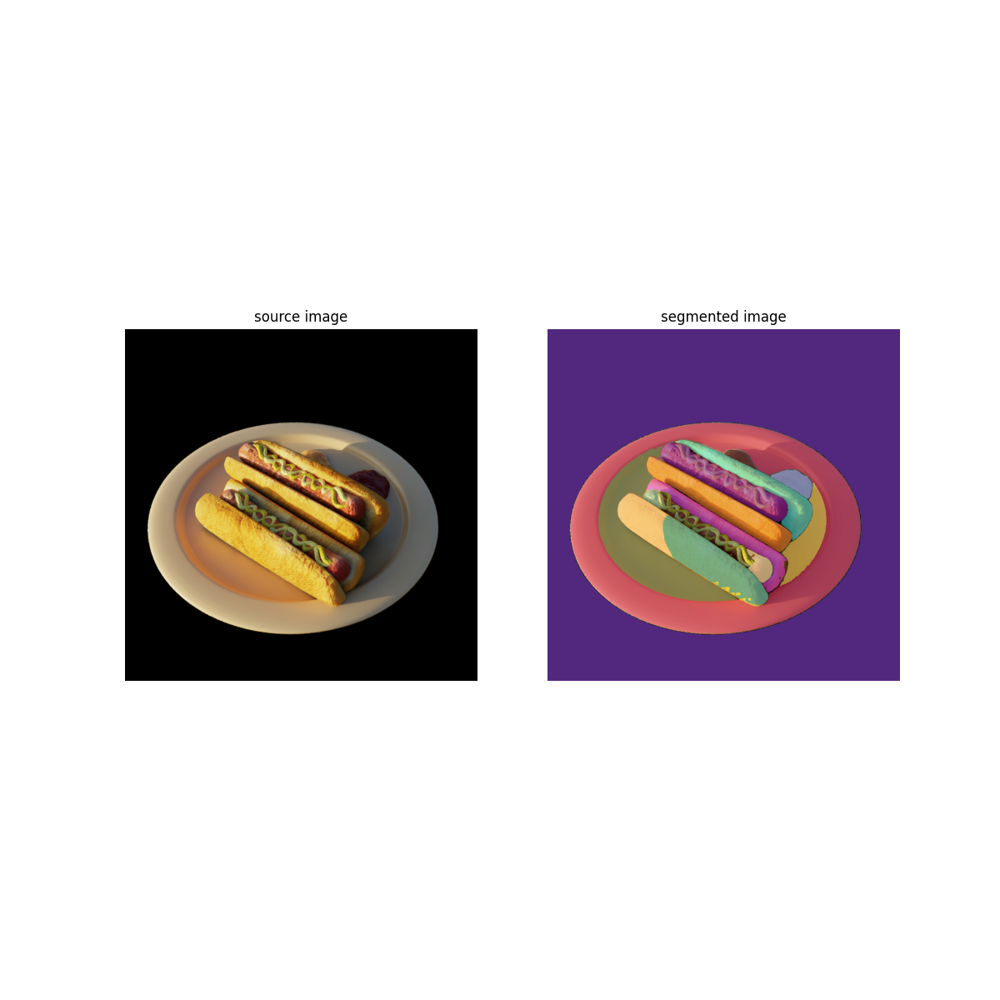

0it [00:00, ?it/s]

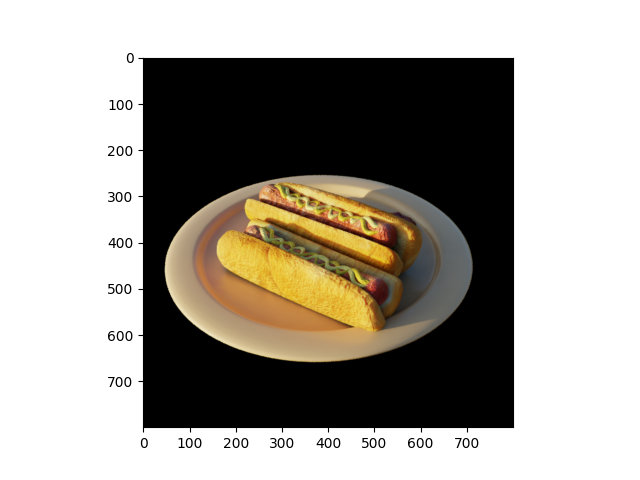

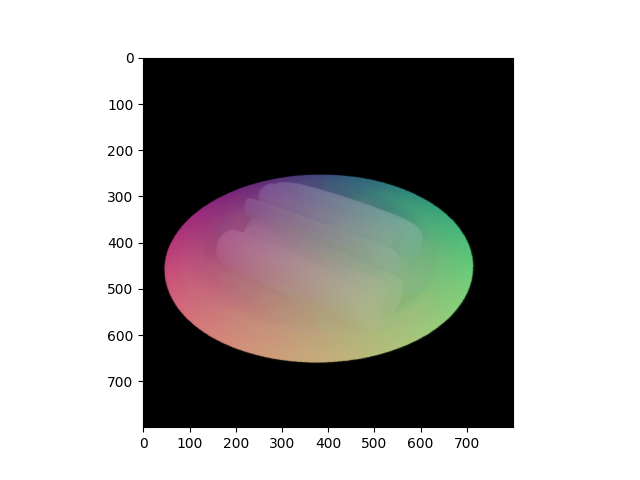

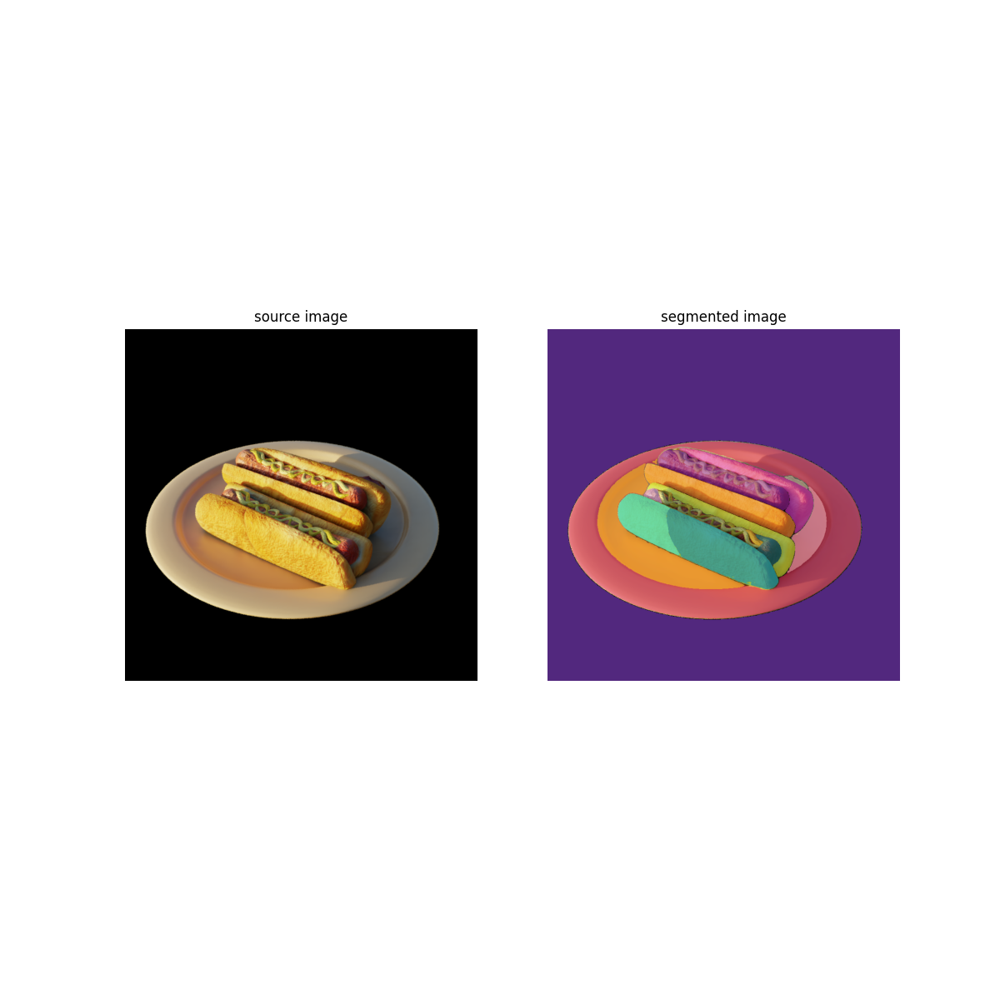

0it [00:00, ?it/s]

In [153]:

surface_points_A, surface_points_masks_list = mark_surface_points(viewpoint_stack=viewpoint_stack, 
                                           gaussians=content_gaussians, 
                                           pipe=pipe, 
                                           background=background,
                                           surface_points=content_surface_pc, #content_surface_pc2,
                                           num_viewpoints=20,
                                          verbose=True)

In [192]:
surface_points_masks = surface_points_masks_list[1]

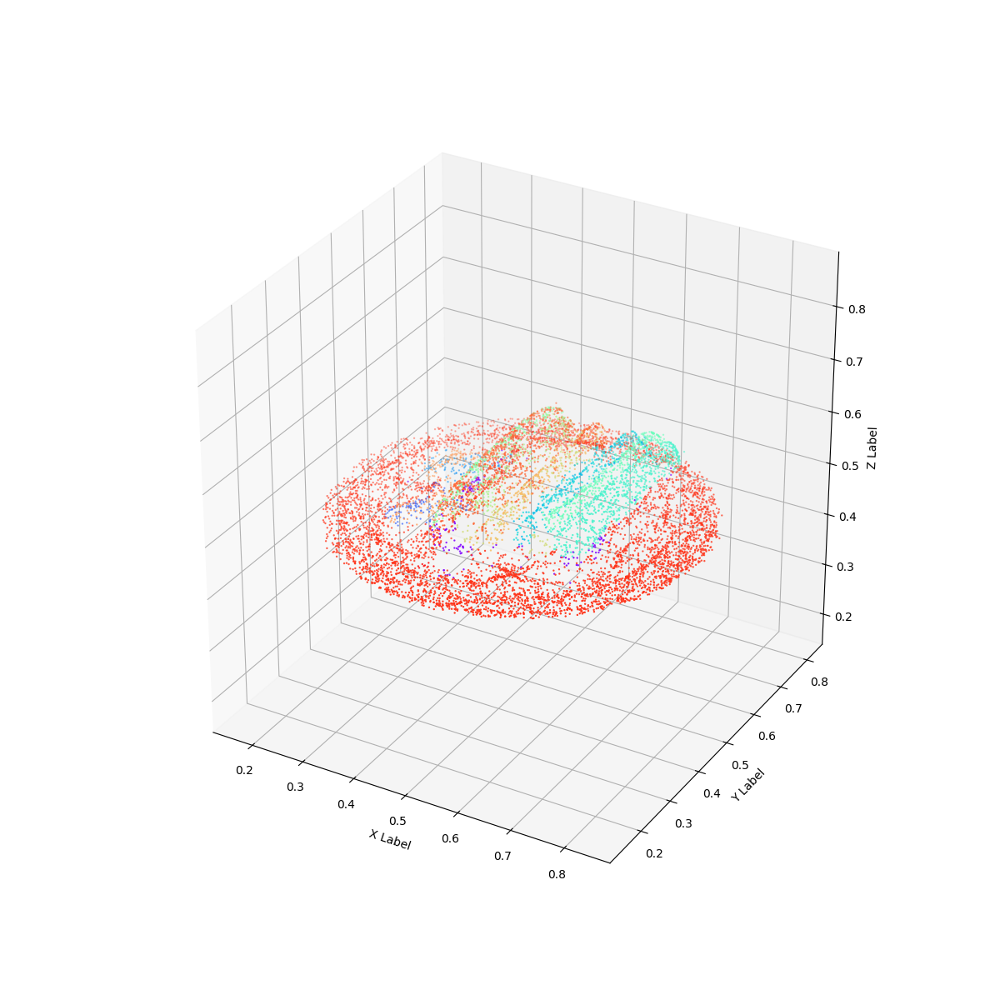

In [193]:
# Create a 3D scatter plot
# Define a colormap (you can choose any other colormap)
colormap = plt.get_cmap('rainbow')

# Normalize the integers to be in the range [0, 1] for colormap mapping
norm = plt.Normalize(surface_points_masks.min(), surface_points_masks.max())

# Map the integers to colors using the colormap
colors = colormap(norm(surface_points_masks))






fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc[::kth,0], 
               content_surface_pc[::kth,1], 
               content_surface_pc[::kth,2], c=colors, marker='o',s=0.5)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

In [134]:
surface_points_A, np.min(surface_points_A), np.max(surface_points_A), np.mean(surface_points_A)

(array([[3, 3, 2, ..., 3, 2, 1],
        [3, 3, 2, ..., 3, 2, 1],
        [2, 2, 2, ..., 2, 2, 1],
        ...,
        [3, 3, 2, ..., 3, 2, 1],
        [2, 2, 2, ..., 2, 2, 1],
        [1, 1, 1, ..., 1, 1, 1]], dtype=int32),
 0,
 3,
 0.7086085195388225)

In [154]:
surface_points_A.shape

(9900, 9900)

In [155]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
from scipy.sparse import coo_matrix


In [156]:
surface_points_A.shape

(9900, 9900)

In [157]:
surface_points

NameError: name 'surface_points' is not defined

In [161]:
surface_points_D = torch.cdist(
            torch.tensor(content_surface_pc).to(device=device).to(dtype=torch.float16),
            torch.tensor(content_surface_pc).to(device=device).to(dtype=torch.float16),  
            p=2) 
surface_points_D = surface_points_D.detach().clone().cpu().numpy()

In [179]:

# Example 2D array
array_2d = np.array(surface_points_A, dtype=np.float32) / np.max(surface_points_A)
print(np.sum(array_2d>0))

if True:
    # Drop elements randomly
    # Define the fraction of elements to set to zero (99%)
    fraction_to_zero = 0.9
    array_2d_mask = np.random.random(array_2d.shape)
    array_2d = array_2d * (array_2d_mask>fraction_to_zero)
else:
    # Leave only elements that are closer then THRESH values
    THRESH = 1e-1
    array_2d = array_2d * (surface_points_D<THRESH)


surface_points_A_sparse = coo_matrix(array_2d, shape=array_2d.shape)


52801346


In [180]:
surface_points_A_sparse

<9900x9900 sparse matrix of type '<class 'numpy.float32'>'
	with 5281215 stored elements in COOrdinate format>

In [181]:
!date
G=nx.from_scipy_sparse_array(surface_points_A_sparse, parallel_edges=False, create_using=None, edge_attribute='weight')
!date

Thu Dec  7 18:06:07 PST 2023
Thu Dec  7 18:06:19 PST 2023


In [141]:
!date
communities = nx.community.louvain_communities(G, resolution=1.,  seed=123)
!date

Thu Dec  7 17:46:29 PST 2023
Thu Dec  7 17:46:48 PST 2023


In [149]:
!date
communities = nx.community.louvain_communities(G, resolution=1.,  seed=123)
!date

Thu Dec  7 17:48:48 PST 2023
Thu Dec  7 17:49:52 PST 2023


In [165]:
!date
communities = nx.community.louvain_communities(G, resolution=1.,  seed=123)
!date

Thu Dec  7 17:59:26 PST 2023
Thu Dec  7 17:59:36 PST 2023


In [186]:
!date
communities = nx.community.louvain_communities(G, resolution=1.5,  seed=123)
!date

Thu Dec  7 18:13:31 PST 2023
Thu Dec  7 18:18:40 PST 2023


In [187]:
len(communities)

74

In [188]:
surface_points_masks = np.zeros(len(content_surface_pc))
for community_lbl, community in enumerate(communities):
    print(list(community))
    surface_points_masks[list(community)] = community_lbl
    

[1922, 3460, 6535, 3339, 2829, 658, 532, 3351, 4632, 7709, 1182, 8482, 3362, 8867, 3875, 8742, 7846, 4648, 9641, 9389, 557, 6963, 3763, 4021, 1980, 9278, 4675, 5830, 2633, 5449, 6474, 3663, 209, 2130, 3926, 2390, 8152, 89, 5208, 5978, 2522, 4439, 2273, 7137, 2532, 3047, 4712, 6631, 1130, 364, 6380, 9838, 2800, 117, 1658, 9723, 7037, 6782, 383]
[4100, 2053, 1028, 6407, 2308, 5898, 7697, 5909, 5655, 1310, 6433, 1058, 3361, 8999, 8233, 2349, 9006, 8749, 1327, 4397, 3380, 4407, 2619, 9024, 6722, 1603, 9284, 3909, 7500, 5461, 1366, 4451, 5222, 6759, 1896, 7784, 9322, 9076, 6772, 8827, 9084, 6013, 1403, 382, 129, 1925, 9869, 3984, 8083, 3480, 1177, 157, 2983, 3240, 171, 3247, 5297, 7092, 1209, 6845, 1982, 8129, 196, 3271, 3786, 1741, 1486, 9677, 8144, 5587, 9685, 984, 7644, 6108, 5343, 3814, 238, 8436, 2555, 7164, 7933]
[1024, 2568, 264, 4874, 5902, 3089, 6168, 4134, 5167, 6960, 5683, 9525, 5691, 6971, 7484, 7742, 7743, 4926, 320, 4420, 5959, 9803, 76, 2131, 5971, 8019, 6488, 5990, 7019, 932

In [144]:
surface_points_masks

array([ 5., 12., 18., ..., 12., 12.,  5.])

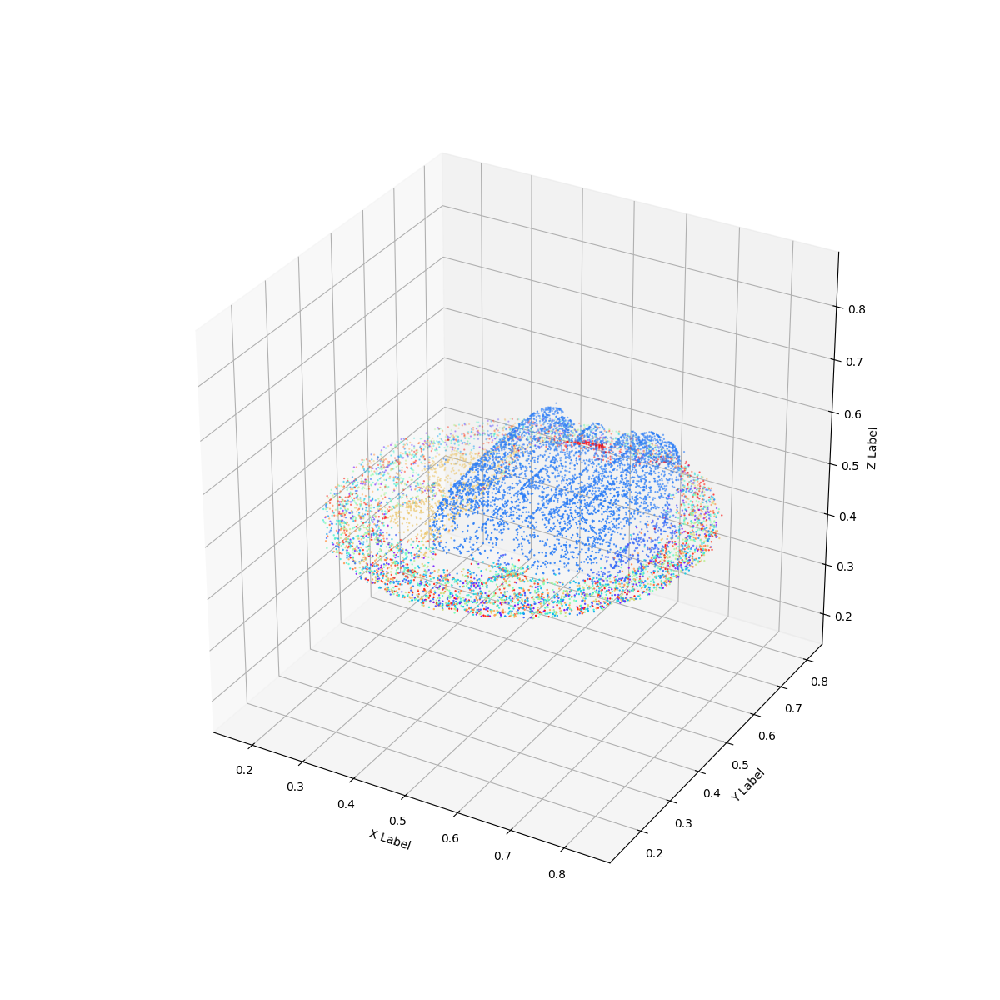

In [189]:
# Create a 3D scatter plot
# Define a colormap (you can choose any other colormap)
colormap = plt.get_cmap('rainbow')

# Normalize the integers to be in the range [0, 1] for colormap mapping
norm = plt.Normalize(surface_points_masks.min(), surface_points_masks.max())

# Map the integers to colors using the colormap
colors = colormap(norm(surface_points_masks))






fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc[::kth,0], 
               content_surface_pc[::kth,1], 
               content_surface_pc[::kth,2], c=colors, marker='o',s=0.5)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

In [111]:
len(communities)

4

In [54]:
zero_indices.shape

(9900, 9801)

In [55]:
surface_points_A_sparse

In [56]:
sparse_matrix

<9900x9900 sparse matrix of type '<class 'numpy.int32'>'
	with 33821125 stored elements in COOrdinate format>

In [52]:
array_2d.shape

(9900, 9900)

In [45]:
print(len(row_indices))
print(len(col_indices))
print(len(data))

97029900
97029900
9900


In [230]:
zero_indices.shape

(10000, 9900)

In [114]:
communities

[{0,
  8193,
  8196,
  5,
  8197,
  11,
  8209,
  8210,
  8211,
  22,
  25,
  8217,
  27,
  8218,
  8221,
  30,
  8225,
  35,
  8228,
  38,
  8231,
  8235,
  43,
  44,
  46,
  45,
  8240,
  8241,
  8242,
  51,
  53,
  8247,
  56,
  57,
  8250,
  59,
  8251,
  61,
  8253,
  64,
  69,
  8263,
  8269,
  85,
  8280,
  8284,
  8286,
  8293,
  104,
  106,
  8301,
  110,
  8303,
  8304,
  118,
  120,
  126,
  8318,
  8321,
  132,
  134,
  8331,
  139,
  8332,
  8334,
  146,
  8339,
  8341,
  8348,
  157,
  162,
  8354,
  164,
  165,
  167,
  170,
  8363,
  172,
  8365,
  173,
  8367,
  8368,
  8366,
  8370,
  8373,
  183,
  8376,
  8377,
  8378,
  190,
  8385,
  8387,
  196,
  8389,
  195,
  199,
  202,
  8398,
  8402,
  8407,
  215,
  217,
  8417,
  8419,
  227,
  229,
  228,
  8424,
  8429,
  238,
  8430,
  8433,
  241,
  247,
  250,
  8442,
  8443,
  258,
  259,
  8450,
  264,
  265,
  266,
  267,
  274,
  8471,
  281,
  286,
  8482,
  291,
  293,
  298,
  8495,
  305,
  8500,
  8501,
  31

In [237]:
A = np.matrix([[1, 1], [1, 2]])
!date
G = nx.DiGraph(surface_points_A_sparse)
!date

Thu Dec  7 16:41:49 PST 2023
Thu Dec  7 16:43:11 PST 2023


In [ ]:
!date
communities = nx.community.louvain_communities(G, seed=123)
!date

Thu Dec  7 16:43:13 PST 2023


In [ ]:
len(communities)

In [ ]:
surface_points_A_sparse

In [ ]:
nx.community.louvain_communities(G, seed=123)

In [153]:
idcs = np.array([1,2,3])
surface_points_A[idcs][:,idcs] =  1 

IndexError: index 3 is out of bounds for axis 0 with size 3

In [233]:
A = np.matrix([[1, 1], [1, 2]])
!date
G = nx.DiGraph(surface_points_A[2000:4000,2000:4000])
!date

Thu Dec  7 16:40:28 PST 2023
Thu Dec  7 16:40:36 PST 2023


In [181]:
np.sum(surface_points_A)

4848452

In [182]:
np.max(surface_points_A)

1

In [134]:
A = np.random.normal(size=(5,5))
print(A)

[[ 0.5819155  -1.00507029 -2.52390684  1.96034122 -1.42573547]
 [ 1.22109257 -0.98524536  1.36601202 -0.11218721  0.41305239]
 [ 0.14262304 -1.22630642  0.51976595 -1.09644022 -1.27687974]
 [ 0.55207546 -0.85228293  0.60762024 -3.57974925  1.23125025]
 [-0.24352757 -2.59558397  1.23248041 -1.63390856 -1.27169624]]


In [176]:
idcs = [1,2,4]
A[idcs][:,idcs] += 1

A[np.ix_(idcs, idcs)] += 1

In [177]:
A

array([[ 0.5819155 , -1.00507029, -2.52390684,  1.96034122, -1.42573547],
       [ 1.22109257,  0.01475464,  2.36601202, -0.11218721,  1.41305239],
       [ 0.14262304, -0.22630642,  1.51976595, -1.09644022, -0.27687974],
       [ 0.55207546, -0.85228293,  0.60762024, -3.57974925,  1.23125025],
       [-0.24352757, -1.59558397,  2.23248041, -1.63390856, -0.27169624]])

In [163]:
from itertools import product

In [171]:
[A[(x,y)] for (x,y) in product(idcs, idcs)]

[-0.9852453624747779,
 1.36601202059296,
 0.41305238753362056,
 -1.226306421203127,
 0.51976595146786,
 -1.2768797410785626,
 -2.5955839733444708,
 1.2324804054822882,
 -1.271696235747452]

In [174]:
import numpy as np

# Example 2D array
array_2d = np.array([
    [1, 2, 3],
    [4, 5, 6],
    [7, 8, 9]
])

# Example indices
idcs = np.array([0, 2])  # For example, rows 0 and 2, columns 0 and 2

# Get the intersection of rows and columns
intersection_rows = array_2d[idcs][:, idcs]

# Increment the values in the intersection
intersection_rows += 1
print(intersection_rows)

print(array_2d)

[[ 2  4]
 [ 8 10]]
[[1 2 3]
 [4 5 6]
 [7 8 9]]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


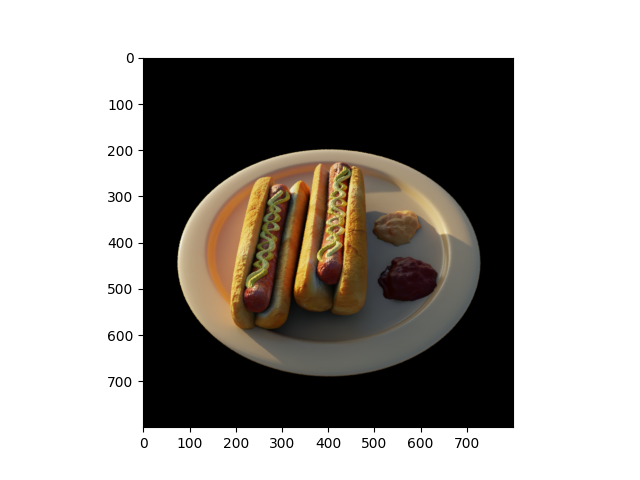

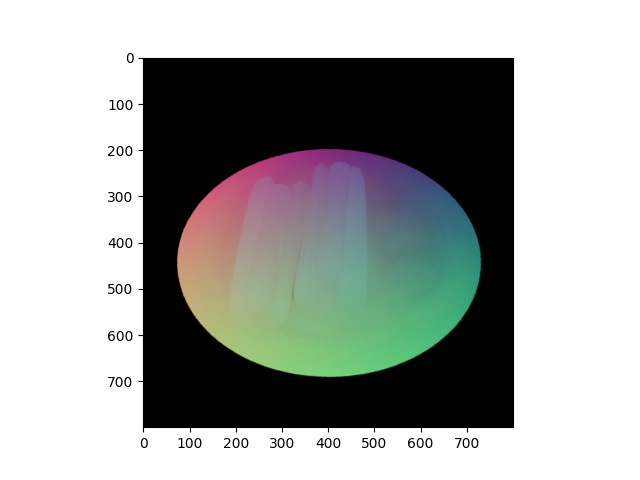

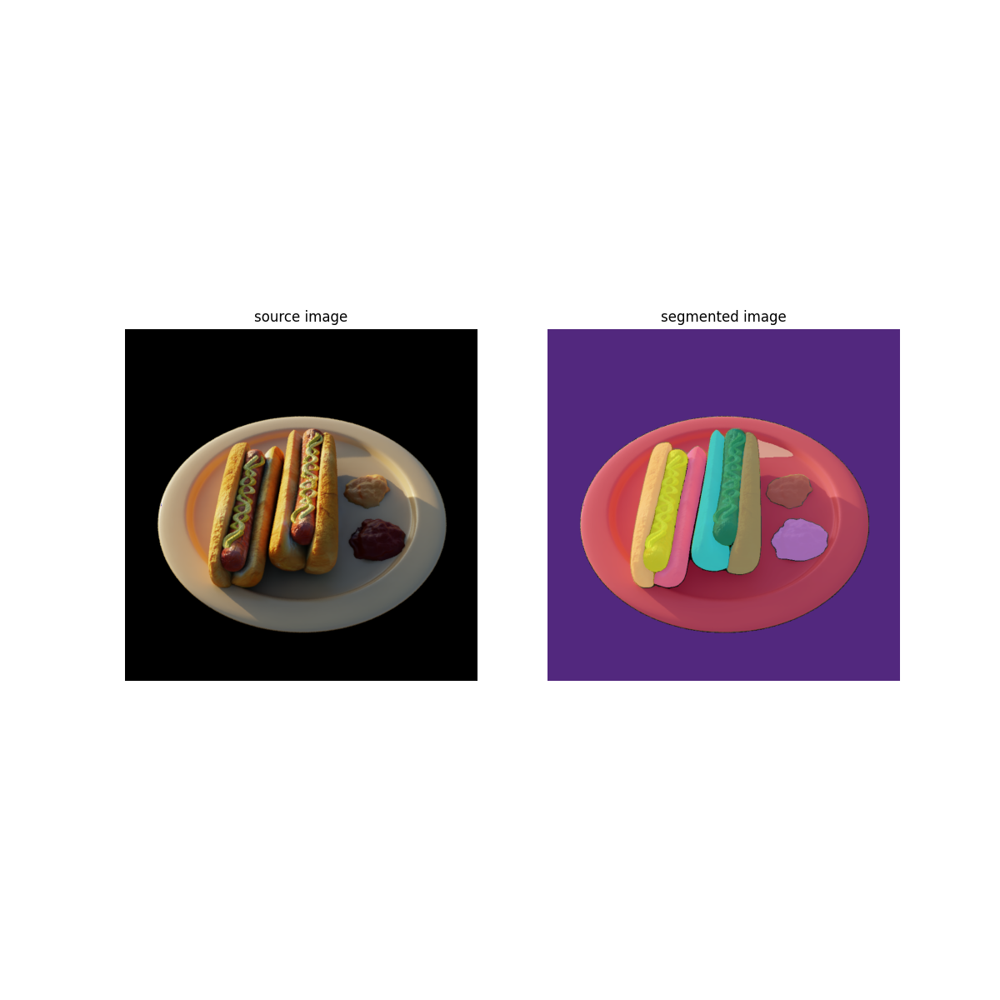

/tmp/ipykernel_1799947/1675825177.py:98: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for mask_idx, mask in tqdm(enumerate(masks)):


0it [00:00, ?it/s]

In [128]:
# masks_points_coords, masks_points_labels = mark_surface_points(viewpoint_stack=viewpoint_stack, 
#                                            gaussians=content_gaussians, 
#                                            pipe=pipe, 
#                                            background=background,
#                                            surface_points=content_surface_pc, #content_surface_pc2,
#                                            num_viewpoints=1,
#                                           verbose=True)

surface_points_masks = mark_surface_points(viewpoint_stack=viewpoint_stack, 
                                           gaussians=content_gaussians, 
                                           pipe=pipe, 
                                           background=background,
                                           surface_points=content_surface_pc, #content_surface_pc2,
                                           num_viewpoints=1,
                                          verbose=True)

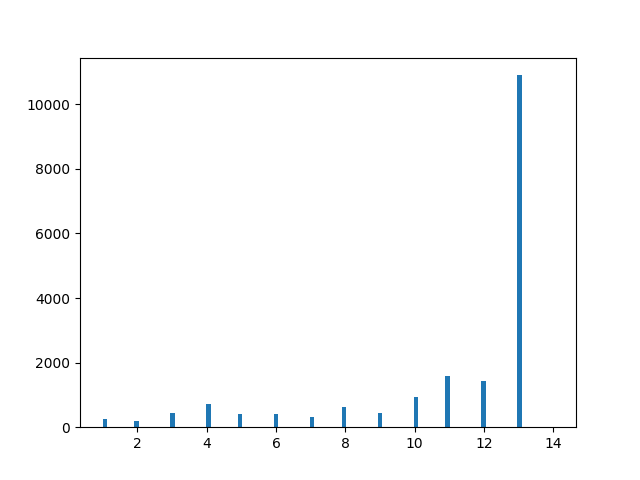

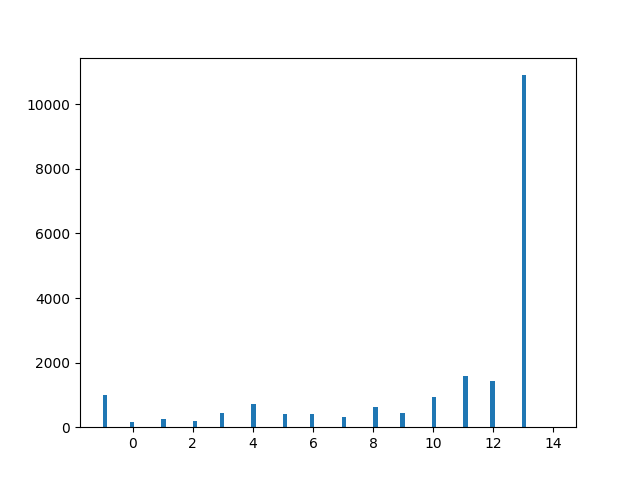

In [129]:
plt.figure()
plt.hist(surface_points_masks[surface_points_masks>0],bins=100)
plt.show()

plt.figure()
plt.hist(surface_points_masks,bins=100)
plt.show()

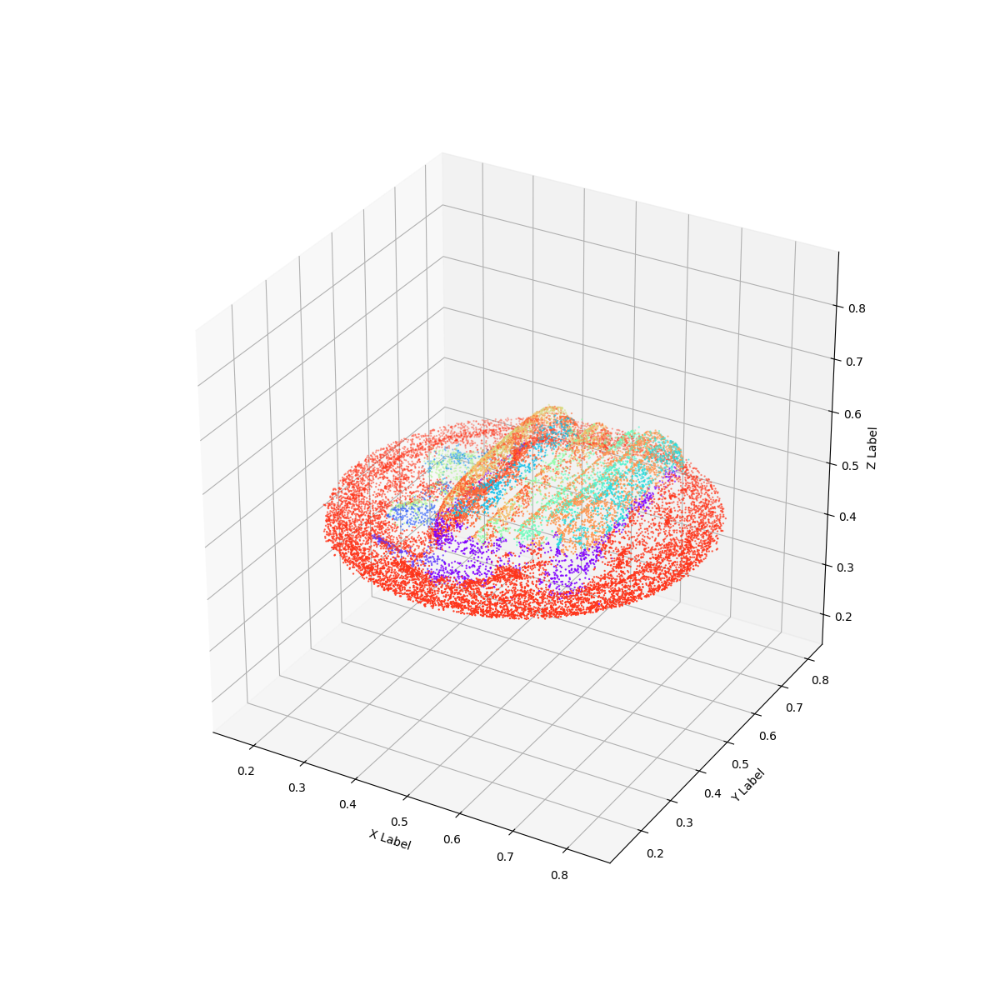

In [130]:
# Create a 3D scatter plot
# Define a colormap (you can choose any other colormap)
colormap = plt.get_cmap('rainbow')

# Normalize the integers to be in the range [0, 1] for colormap mapping
norm = plt.Normalize(surface_points_masks.min(), surface_points_masks.max())

# Map the integers to colors using the colormap
colors = colormap(norm(surface_points_masks))






fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc[::kth,0], 
               content_surface_pc[::kth,1], 
               content_surface_pc[::kth,2], c=colors, marker='o',s=0.5)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

In [73]:
masks_points_coords = np.concatenate(masks_points_coords, axis=0)
masks_points_labels = np.concatenate(masks_points_labels, axis=0)


In [76]:
500**2

250000

In [75]:
masks_points_coords.shape

(1250989, 3)

In [ ]:
# Create a 3D scatter plot
# Define a colormap (you can choose any other colormap)
colormap = plt.get_cmap('rainbow')

# Normalize the integers to be in the range [0, 1] for colormap mapping
norm = plt.Normalize(masks_points_labels.min(), masks_points_labels.max())

# Map the integers to colors using the colormap
colors = colormap(norm(masks_points_labels))






fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(masks_points_coords[::kth,0], 
               masks_points_coords[::kth,1], 
               masks_points_coords[::kth,2], c=colors, marker='o',s=0.1)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

In [64]:
content_surface_pc

array([[0.549486  , 0.4216107 , 0.5377748 ],
       [0.44159597, 0.6906426 , 0.52874106],
       [0.4112829 , 0.33854657, 0.4972466 ],
       ...,
       [0.39587316, 0.6233129 , 0.48287508],
       [0.46358195, 0.7044389 , 0.50047684],
       [0.2666287 , 0.2865162 , 0.4746798 ]], dtype=float32)

In [179]:
np.random.normal(size=(10_000, 3)).shape

(10000, 3)

In [181]:
300**2

90000

In [199]:
from scipy.spatial import distance
! date
pairwise_distances = distance.cdist(np.random.normal(size=(10_000, 3)),  np.random.normal(size=(500**2, 3)), 'euclidean')
surface_points_nearest_idcs_to_mask = np.argmin(pairwise_distances, axis=1)
! date


Tue Dec  5 14:46:06 PST 2023
Tue Dec  5 14:46:24 PST 2023


In [203]:
from scipy.spatial import distance
! date
pairwise_distances = torch.cdist(
    torch.tensor(np.random.normal(size=(30_000, 3))).to(device=device).to(dtype=torch.float16),  
    torch.tensor(np.random.normal(size=(500**1, 3))).to(device=device).to(dtype=torch.float16), p=2)
surface_points_nearest_idcs_to_mask = torch.argmin(pairwise_distances, axis=1)
surface_points_nearest_idcs_to_mask = surface_points_nearest_idcs_to_mask.detach().cpu().numpy()
! date


Tue Dec  5 15:14:58 PST 2023
Tue Dec  5 15:14:58 PST 2023


In [205]:
surface_points_nearest_idcs_to_mask.detach().cpu().numpy()

array([235,  68, 474, ..., 322, 491, 496])

In [184]:
from scipy.spatial import distance
! date
pairwise_distances = distance.cdist(np.random.normal(size=(10_000, 3)),  np.random.normal(size=(100**2, 3)), 'euclidean')
! date


Tue Dec  5 14:40:34 PST 2023
Tue Dec  5 14:40:35 PST 2023


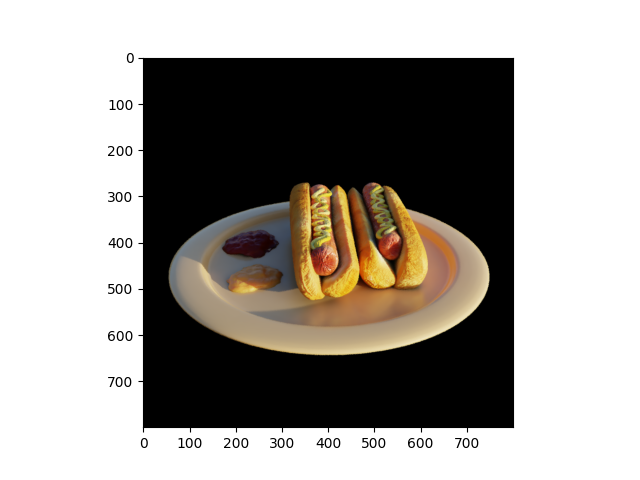

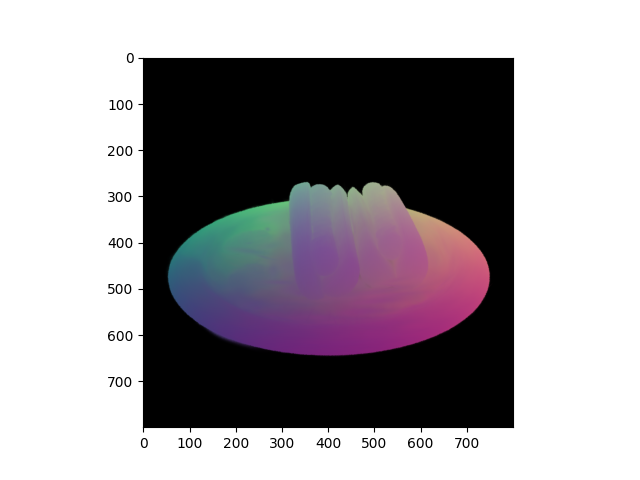

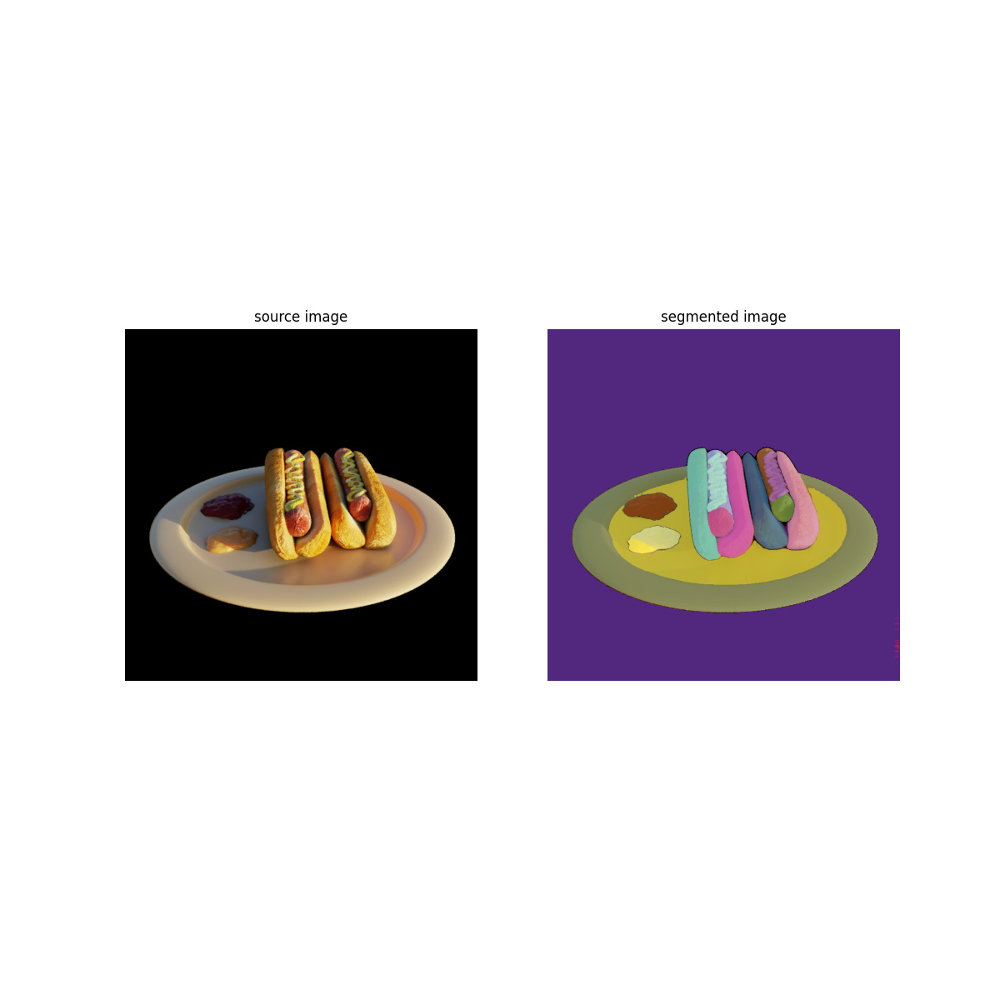

/tmp/ipykernel_1799947/1969162638.py:74: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for mask_idx, mask in tqdm(enumerate(masks)):


0it [00:00, ?it/s]

len(mask_points): 1340
mask_points[:30]: [[0.2976933  0.39211383 0.4745874 ]
 [0.29831585 0.39056715 0.47472003]
 [0.2977641  0.38951546 0.4742488 ]
 [0.2984358  0.3884191  0.47447556]
 [0.29801363 0.3881705  0.4742055 ]
 [0.29908463 0.38637978 0.47437355]
 [0.29891205 0.38737273 0.47455034]
 [0.29860374 0.38660303 0.47407144]
 [0.2991284  0.38604528 0.47426176]
 [0.29957002 0.38561323 0.4744326 ]
 [0.29876748 0.3860719  0.47413972]
 [0.30001256 0.38499776 0.4745877 ]
 [0.30056548 0.38446698 0.47477818]
 [0.29732594 0.385987   0.4734141 ]
 [0.29924762 0.38399696 0.4739443 ]
 [0.30076653 0.3832308  0.47469604]
 [0.30192474 0.38234156 0.47523272]
 [0.3037572  0.38140982 0.47562075]
 [0.30399445 0.3820995  0.47593707]
 [0.30468524 0.382124   0.47618487]
 [0.30620337 0.38085434 0.47635612]
 [0.30592704 0.38193694 0.47681955]
 [0.30717593 0.3802224  0.47648066]
 [0.30730578 0.38044685 0.47648424]
 [0.30793947 0.3801088  0.476127  ]
 [0.3082973  0.3792327  0.47593263]
 [0.29626906 0.38592312

In [66]:
surface_points_masks = mark_surface_points(viewpoint_stack=viewpoint_stack, 
                                           gaussians=content_gaussians, 
                                           pipe=pipe, 
                                           background=background,
                                           surface_points=content_surface_pc, #content_surface_pc2,
                                           num_viewpoints=1,
                                          verbose=True)

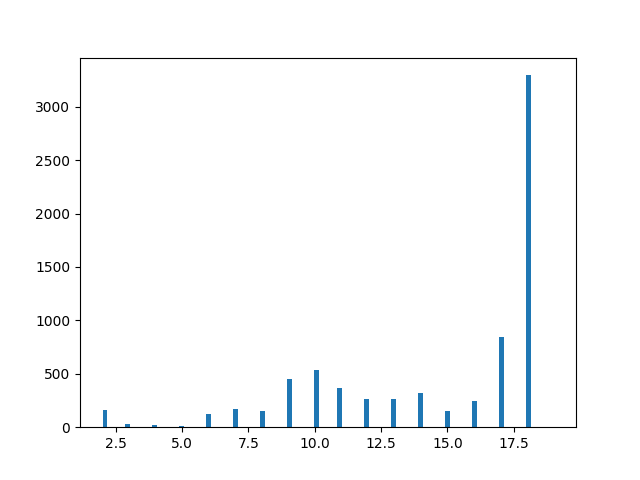

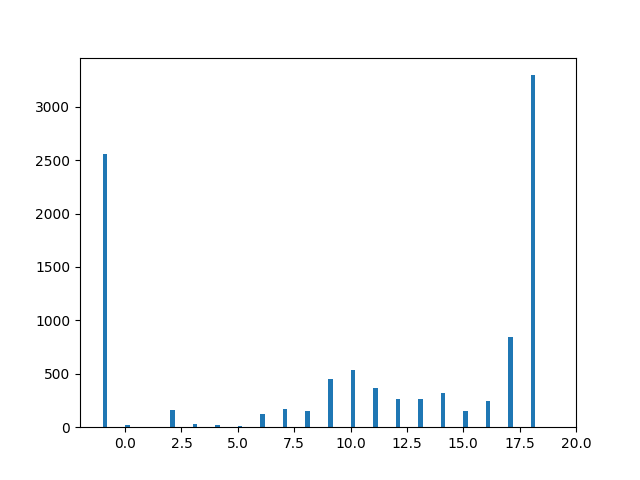

In [84]:
plt.figure()
plt.hist(surface_points_masks[surface_points_masks>0],bins=100)
plt.show()

plt.figure()
plt.hist(surface_points_masks,bins=100)
plt.show()

In [67]:
np.unique(surface_points_masks, return_counts=True)

(array([-1,  7,  9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20], dtype=int32),
 array([6673,   85,    5,    2,  167,    1,  388,    3,  600,   35,   10,
        1923,  108]))

In [2]:
# Create a 3D scatter plot
# Define a colormap (you can choose any other colormap)
colormap = plt.get_cmap('rainbow')

# Normalize the integers to be in the range [0, 1] for colormap mapping
norm = plt.Normalize(surface_points_masks.min(), surface_points_masks.max())

# Map the integers to colors using the colormap
colors = colormap(norm(surface_points_masks))






fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc[::kth,0], 
               content_surface_pc[::kth,1], 
               content_surface_pc[::kth,2], c=colors, marker='o',s=0.1)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

NameError: name 'plt' is not defined